<a href="https://colab.research.google.com/github/majesticio/Box_Office_Predictions/blob/master/HeadStartCapstone_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

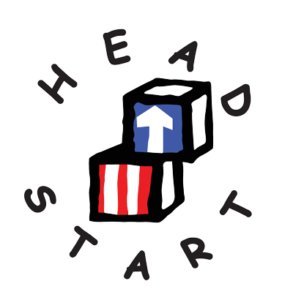

#Head Start Capstone
*Using data science to identify underserved communities in New Mexico for Head Start*

---
by **Alija Blackwell, Kathleen Mattos**, and **Gabriel Fosse**


##Problem Definition

How can we identify communities that could benefit the most from additional Head Start locations and funding, using machine learning tools like Kmeans and Hierarchical Clustering?

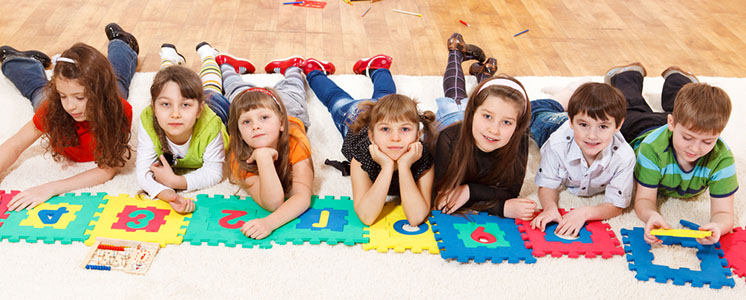

##Import Libraries

In [ ]:
!pip install geopandas

     |████████████████████████████████| 972kB 5.1MB/s 
     |████████████████████████████████| 14.8MB 297kB/s 
     |████████████████████████████████| 6.5MB 24.2MB/s 


In [ ]:
import branca.colormap as cm
import datetime
import folium
from folium import plugins, FeatureGroup
import geopandas
import json
import numpy as np
import pandas as pd
import requests
from shapely.geometry import Point, Polygon
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.preprocessing import normalize
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import seaborn as sns
from sklearn import preprocessing
import xgboost as xgb
from numpy import loadtxt
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
import statsmodels.api as sm
from math import radians, cos, sin, asin, sqrt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


*Pandas parameters*

In [ ]:
pd.set_option('display.max_rows', 150)
pd.set_option('display.max_columns', 150)

##Data Collection

We will be using education by Census tract data, New Mexico Census data, Head Start and Early Headstart location data, and Census tract polygons data for geopandas maps.

###File Locations



In [ ]:
education_path = '/content/drive/My Drive/The Brain Gang/Final_Data/education_bytracts2018[1].geojson'
nm_census_path = '/content/drive/My Drive/The Brain Gang/Final_Data/census_nm.csv'
hs_locations_path = '/content/drive/My Drive/The Brain Gang/Final_Data/Head_Start_Map_Full_Data_data.csv'
early_hs_locations_path = '/content/drive/My Drive/The Brain Gang/Final_Data/Early_Head_Start_Map_Full_Data_data.csv'
census_geojson_path = '/content/drive/My Drive/The Brain Gang/Final_Data/2017_NM_tract.geojson'

#### New Mexico Education Tracts

New Mexico education tracts dataset includes educational attainment information and current population enrolled in school for each census tract. 
  - Source: http://rgis.unm.edu/spatialsearch/# 
  - Data Dictionary: https://gstore.unm.edu/apps/rgis/datasets/ccc3056e-ce9d-4fdc-a550-fef7c09648fb/metadata/FGDC-STD-001-1998.html

In [ ]:
education_tracts_original = geopandas.read_file(education_path, driver='GeoJSON')

#### NM Census Demographic Data

Retrieved from the U.S. Census, the New Mexico Census dataset includes demographic information covering gender, race/ethnicity, age, income, employment, and transit methods for each county and census tract.
Source: https://www.kaggle.com/muonneutrino/us-census-demographic-data?select=acs2017_census_tract_data.csv

In [ ]:
nm_census_original = pd.read_csv(nm_census_path)

####Head Start Locations

Regular Head Start Locations

Retrieved from UNM's Cradle to Career Policy Institute's early childhood education map visualization, this dataset includes New Mexico Head Start centers' location data: county, latitude/longitude, program name, and enrollment information.
- Source: https://ccpi.unm.edu/visualizations/nm-early-childhood-care-and-education-services-fy-20

In [ ]:
reg_hs_locations_original = pd.read_csv(hs_locations_path)

Early Head Start Locations

Retrieved from UNM's Cradle to Career Policy Institute's early childhood education map visualization, this dataset includes New Mexico Early Head Start centers' location data: county, latitude/longitude, program name, and enrollment information.
- Source: https://ccpi.unm.edu/visualizations/nm-early-childhood-care-and-education-services-fy-20

In [ ]:
early_hs_locations_original = pd.read_csv(early_hs_locations_path)

#### Census Tract GeoJSON

Census Tract GeoJSON includes polygon shape dimensions for the New Mexico census tracts to support mapping visualization.
- Source: https://www.census.gov/cgi-bin/geo/shapefiles/index.php?year=2017&layergroup=Census+Tracts

In [ ]:
census_tract_geojson_original = geopandas.read_file(census_geojson_path)

##Data Cleaning

For this project we will be using several datasets that will need to be cleaned individually and merged later. These datasets include:

    New Mexico Census Data
    Headstart Locations Data
    Education stats split by Census Tracts
    Geojson containing the shapes of the Census Tracts



###New Mexico Census Data

Create a copy of the dataframe for editing purposes.

In [ ]:
nm_census = nm_census_original.copy()

Let's look at the columns and the types of data stored in them.

In [ ]:
nm_census.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 499 entries, 0 to 498
Data columns (total 38 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        499 non-null    int64  
 1   TractId           499 non-null    int64  
 2   State             499 non-null    object 
 3   County            499 non-null    object 
 4   TotalPop          499 non-null    int64  
 5   Men               499 non-null    int64  
 6   Women             499 non-null    int64  
 7   Hispanic          498 non-null    float64
 8   White             498 non-null    float64
 9   Black             498 non-null    float64
 10  Native            498 non-null    float64
 11  Asian             498 non-null    float64
 12  Pacific           498 non-null    float64
 13  VotingAgeCitizen  499 non-null    int64  
 14  Income            498 non-null    float64
 15  IncomeErr         498 non-null    float64
 16  IncomePerCap      498 non-null    float64
 1

From this cursory look we can gather a few things about this dataset...
- 38 columns
- 499 entries (rows)
- mostly numerical values with a couple of text columns
- a good portion of the rows have one null value

Let's take a look at the null value situation.

In [ ]:
nm_census[nm_census['Hispanic'].isnull()]

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
365,43061,35043940300,New Mexico,Sandoval County,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN


Row index 365 is incomplete, causing the null values across the board. Since it still has it's TractId number we will keep it for now so that there won't be an empty spot when we map the tracts. Once we get to the processing we will drop it since it adds nothing positive.

Moving on to getting this data ready for merging, let's check the TractId column to see if each entry has a unique value.

In [ ]:
nm_census['TractId'].nunique()

499

Great! That means each row in this column is unique and a viable option to merge on. In order to get the TractId to the same name as the other datasets we are going to rename it to "Tracts."

In [ ]:
nm_census = nm_census.rename(columns={"TractId":"Tracts"})
nm_census.head()

,Unnamed: 0,Tracts,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,42696,35001000107,New Mexico,Bernalillo County,2473,1253,1220,18.6,73.9,3.9,2.7,0.9,0.0,2048,85750.0,13103.0,49431.0,5574.0,7.1,0.0,58.7,9.2,25.6,3.3,3.2,79.9,4.5,1.4,1.7,2.3,10.2,21.3,1144,78.3,17.4,4.3,0.0,6.2
1,42697,35001000108,New Mexico,Bernalillo County,3258,1433,1825,23.1,61.2,1.6,10.6,0.0,0.0,2400,63621.0,13883.0,28099.0,3108.0,8.1,5.3,41.4,23.8,22.7,7.7,4.3,92.9,3.1,0.5,0.3,0.5,2.7,24.4,1473,75.6,21.4,3.0,0.0,1.8
2,42698,35001000109,New Mexico,Bernalillo County,2532,1243,1289,23.0,63.0,0.8,10.0,1.2,0.0,1919,74524.0,11389.0,32299.0,3482.0,10.6,24.6,46.2,14.6,25.3,9.1,4.8,85.6,5.3,3.3,0.0,1.8,4.1,25.2,1122,74.5,18.3,6.6,0.6,13.0
3,42699,35001000110,New Mexico,Bernalillo County,3866,1915,1951,33.1,57.4,2.1,4.6,0.0,0.4,3072,35066.0,3360.0,22567.0,3649.0,23.6,24.7,33.8,35.5,19.2,7.2,4.2,76.9,6.3,4.0,4.9,3.3,4.6,21.9,2009,70.5,19.5,10.0,0.0,4.7
4,42700,35001000111,New Mexico,Bernalillo County,2994,1395,1599,24.7,61.2,3.2,0.0,5.5,0.0,2241,80000.0,6017.0,31496.0,3326.0,8.1,8.2,54.0,15.0,19.4,5.7,5.9,82.6,13.4,0.1,0.7,1.7,1.5,22.5,1371,64.8,29.0,6.1,0.0,4.1


One last thing to fix our new Tracts column is that it is currently stored as an integer, but for consistancy we need it to be a string.

In [ ]:
nm_census['Tracts'] = nm_census['Tracts'].map(str)
nm_census.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 499 entries, 0 to 498
Data columns (total 38 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        499 non-null    int64  
 1   Tracts            499 non-null    object 
 2   State             499 non-null    object 
 3   County            499 non-null    object 
 4   TotalPop          499 non-null    int64  
 5   Men               499 non-null    int64  
 6   Women             499 non-null    int64  
 7   Hispanic          498 non-null    float64
 8   White             498 non-null    float64
 9   Black             498 non-null    float64
 10  Native            498 non-null    float64
 11  Asian             498 non-null    float64
 12  Pacific           498 non-null    float64
 13  VotingAgeCitizen  499 non-null    int64  
 14  Income            498 non-null    float64
 15  IncomeErr         498 non-null    float64
 16  IncomePerCap      498 non-null    float64
 1

###Head Start Locations (Regular and Early)

Create copies for editing purposes.

In [ ]:
reg_hs_locations = reg_hs_locations_original.copy()

In [ ]:
early_hs_locations = early_hs_locations_original.copy()

Let's take a quick look at the structure of this dataframe.

In [ ]:
reg_hs_locations.head()

,County,ID,Program Type,Program name,80% Total,Adj%,Funded Slots,Latitude,Longitude
0,Lea,123,Head Start,Child and Family Services of Lea County (Washi...,432,59%,92,32.689066,-103.134259
1,Lea,124,Head Start,Child and Family Services of Lea County (Hillc...,432,59%,32,32.936645,-103.353560
2,Lea,125,Head Start,Child and Family Services of Lea County (Tieuel),432,59%,133,32.704390,-103.126155
3,San Miguel,134,Head Start,Eastern Plains CAA (Anton Chico Head Start),268,58%,15,35.220314,-105.168963
4,Curry,135,Head Start,Eastern Plains CAA (Clovis Head Start),548,26%,140,34.407200,-103.230723


The Funded Slots column represents the number of children currently being served at that location. Reporting zero funded slots could mean that the location is not currently operating or just didn't report the data. Either way it is not really helpful information to us. Let's check how many are reporting zero funded slots.

In [ ]:
reg_hs_locations[reg_hs_locations['Funded Slots'] == 0]

,County,ID,Program Type,Program name,80% Total,Adj%,Funded Slots,Latitude,Longitude
140,Catron,3921,Tribal Head Start,No Services Identified,30,0%,0,NaN,NaN
141,Catron,3926,Head Start,No Services Identified,30,0%,0,NaN,NaN
142,Chaves,3931,Tribal Head Start,No Services Identified,551,68%,0,NaN,NaN
143,Colfax,3937,Tribal Head Start,No Services Identified,100,80%,0,NaN,NaN
144,Curry,3942,Tribal Head Start,No Services Identified,548,26%,0,NaN,NaN
145,De Baca,3945,Tribal Head Start,No Services Identified,0,NaN,0,NaN,NaN
146,Doña Ana,3948,Tribal Head Start,No Services Identified,"2,013",35%,0,NaN,NaN
147,Eddy,3953,Tribal Head Start,No Services Identified,338,100%,0,NaN,NaN
148,Grant,3955,Tribal Head Start,No Services Identified,170,99%,0,NaN,NaN
149,Guadalupe,3959,Tribal Head Start,No Services Identified,28,61%,0,NaN,NaN


From the entries with 0 funded slots there seem to be a lot of Tribal Headstart locations. Do any of the Tribal locations have funded slots?

In [ ]:
#check all Tribal Head Start locations to crosscheck with 47 OHS center locator data
reg_hs_locations[reg_hs_locations['Program Type'] == 'Tribal Head Start']

,County,ID,Program Type,Program name,80% Total,Adj%,Funded Slots,Latitude,Longitude
113,Rio Arriba,3423,Tribal Head Start,Santa Clara Pueblo Head Start,277,100%,29,35.972831,-106.088441
114,Sandoval,3431,Tribal Head Start,San Felipe Pueblo Head Start,612,89%,96,35.405109,-106.439752
115,Sandoval,3436,Tribal Head Start,Five Sandoval Indian Pueblos (Zia Pueblo Head ...,612,89%,20,35.509539,-106.710602
118,Sandoval,3496,Tribal Head Start,Walatowa Head Start,612,89%,68,35.605243,-106.730716
119,Rio Arriba,3503,Tribal Head Start,Jicarilla Apache Head Start,277,100%,102,36.940281,-106.989866
120,Cibola,3505,Tribal Head Start,Haak'u Learning Center Head Start,234,100%,112,35.042596,-107.616633
121,Santa Fe,3511,Tribal Head Start,Eight Northern Pueblos (Nambe Head Start),593,69%,18,35.885853,-105.962150
122,Rio Arriba,3523,Tribal Head Start,Ohkay Owingeh Head Start,277,100%,81,36.054323,-106.071119
123,Taos,3542,Tribal Head Start,Taos Pueblo Head Start,102,100%,38,36.434960,-105.544165
124,Sandoval,3550,Tribal Head Start,Five Sandoval Indian Pueblos (Santa Ana Head S...,612,89%,13,35.343663,-106.532844


So there are some Tribal Headstart locations with funded slots, which is good news but the ones that have 0 could be no longer operating or didn't report data. This will probably come into play later but for now we will continue with only locations that have one or more funded slots.

In [ ]:
#check head start locations where funded enrollment slots
reg_hs_locations = reg_hs_locations[reg_hs_locations['Funded Slots'] != 0]

Now let's move onto the Early Headstart locations, first we will check if there are empty values in the Latitude column

In [ ]:
#check early head start centers where latitude data is not available
early_hs_locations[early_hs_locations['Latitude'].isnull()]

,County,ID,Program Type,Program name,50 Percent Target,Adj%,Funded Slots,Latitude,Longitude
20,Catron,3920,Tribal Early Head Start,No Service Identified,8,0%,0,NaN,NaN
21,Catron,3925,Early Head Start,No Service Identified,8,0%,0,NaN,NaN
23,Chaves,3930,Tribal Early Head Start,No Service Identified,381,0%,0,NaN,NaN
24,Chaves,3932,Early Head Start,No Service Identified,381,0%,0,NaN,NaN
27,Cibola,3935,Early Head Start,No Service Identified,164,41%,0,NaN,NaN
29,Colfax,3936,Tribal Early Head Start,No Service Identified,56,14%,0,NaN,NaN
31,Curry,3941,Tribal Early Head Start,No Service Identified,275,12%,0,NaN,NaN
32,De Baca,3944,Tribal Early Head Start,No Service Identified,8,0%,0,NaN,NaN
33,De Baca,3958,Early Head Start,No Service Identified,8,0%,0,NaN,NaN
40,Doña Ana,3947,Tribal Early Head Start,No Service Identified,NaN,NaN,0,NaN,NaN


Same as the last one, we should check the Tribal Headstart locations to see if it has the same problem as the regular Headstart data.

In [ ]:
#check all Tribal Early Head Start locations to crosscheck with 47 OHS center locator data
early_hs_locations[early_hs_locations['Program Type'] == 'Tribal Early Head Start']

,County,ID,Program Type,Program name,50 Percent Target,Adj%,Funded Slots,Latitude,Longitude
13,Bernalillo,3552,Tribal Early Head Start,Pueblo Of Isleta Early Head Start,"2,617",19%,48,34.902773,-106.720864
20,Catron,3920,Tribal Early Head Start,No Service Identified,8,0%,0,NaN,NaN
23,Chaves,3930,Tribal Early Head Start,No Service Identified,381,0%,0,NaN,NaN
26,Cibola,3463,Tribal Early Head Start,Pueblo of Laguna Early Head Start,164,41%,67,35.037946,-107.385923
29,Colfax,3936,Tribal Early Head Start,No Service Identified,56,14%,0,NaN,NaN
31,Curry,3941,Tribal Early Head Start,No Service Identified,275,12%,0,NaN,NaN
32,De Baca,3944,Tribal Early Head Start,No Service Identified,8,0%,0,NaN,NaN
40,Doña Ana,3947,Tribal Early Head Start,No Service Identified,NaN,NaN,0,NaN,NaN
42,Eddy,3952,Tribal Early Head Start,No Service Identified,315,0%,0,NaN,NaN
45,Grant,3954,Tribal Early Head Start,No Service Identified,103,8%,0,NaN,NaN


Since we need the location data for the mapping we are going to drop all the locations that do not have Latitude and Longitude as well as zeros in the funded slots column.

In [ ]:
#update the early head start location dataframe to only include centers with latitude data available
early_hs_locations = early_hs_locations[early_hs_locations['Latitude'].notnull()]
early_hs_locations = early_hs_locations[early_hs_locations['Funded Slots'] != 0]
early_hs_locations

,County,ID,Program Type,Program name,50 Percent Target,Adj%,Funded Slots,Latitude,Longitude
0,Bernalillo,126,Early Head Start,CABQ Douglas MacArthur Early Head Start,"2,617",19%,16,35.137056,-106.650763
1,Bernalillo,127,Early Head Start,CABQ La Mesa Early Head Start,"2,617",19%,8,35.080080,-106.563000
2,Bernalillo,128,Early Head Start,CABQ Plaza Feliz Early Head Start,"2,617",19%,16,35.070094,-106.563569
3,Bernalillo,129,Early Head Start,CABQ School on Wheels Early Head Start,"2,617",19%,16,35.068150,-106.668314
4,Bernalillo,131,Early Head Start,CABQ Trumbull Eearly Head Start,"2,617",19%,16,35.069915,-106.559801
5,Bernalillo,132,Early Head Start,CABQ Valle Del Norte Early Head Start,"2,617",19%,24,35.123484,-106.664432
6,Bernalillo,133,Early Head Start,CABQ Western Trails Early Head Start,"2,617",19%,16,35.133300,-106.714393
7,Bernalillo,189,Early Head Start,NAPPR Early Head Start Child Care Center,"2,617",19%,72,35.088472,-106.613373
8,Bernalillo,264,Early Head Start,YDI Head Start (First Fruits Christian Academy),"2,617",19%,24,35.082741,-106.728730
9,Bernalillo,265,Early Head Start,YDI Head Start (St. Marks in the Valley Day Sc...,"2,617",19%,16,35.115894,-106.639883


####All Head Start Locations

Combine the early and regular Headstart tables together and reindex them to be one cohesive dataframe.

In [ ]:
all_hs_locations = pd.concat([reg_hs_locations, early_hs_locations], axis=0)
all_hs_locations = all_hs_locations.reset_index(drop=True)
all_hs_locations

,County,ID,Program Type,Program name,80% Total,Adj%,Funded Slots,Latitude,Longitude,50 Percent Target
0,Lea,123,Head Start,Child and Family Services of Lea County (Washi...,432,59%,92,32.689066,-103.134259,NaN
1,Lea,124,Head Start,Child and Family Services of Lea County (Hillc...,432,59%,32,32.936645,-103.353560,NaN
2,Lea,125,Head Start,Child and Family Services of Lea County (Tieuel),432,59%,133,32.704390,-103.126155,NaN
3,San Miguel,134,Head Start,Eastern Plains CAA (Anton Chico Head Start),268,58%,15,35.220314,-105.168963,NaN
4,Curry,135,Head Start,Eastern Plains CAA (Clovis Head Start),548,26%,140,34.407200,-103.230723,NaN
...,...,...,...,...,...,...,...,...,...,...
199,Taos,3621,Early Head Start,YDI Early Head Start (Enos Garcia),NaN,47%,8,36.408044,-105.578229,127
200,Taos,3686,Early Head Start,YDI Head Start (Vadito),NaN,47%,8,36.215983,-105.631641,127
201,Taos,3722,Early Head Start,YDI Head Start (Llano Quemado),NaN,47%,44,36.354998,-105.614879,127
202,Torrance,3706,Early Head Start,PMS Headstart (Estancia),NaN,50%,44,34.755732,-106.063306,121


In [ ]:
type(all_hs_locations)

pandas.core.frame.DataFrame

In [ ]:
#all_hs_locations.to_csv('/content/drive/MyDrive/Colab Notebooks/csv files/all_hs_locs.csv')

### Education Tracts



Create a copy for editing purposes.

In [ ]:
education_tracts = education_tracts_original.copy()
education_tracts.head(3)

,FPOP_3PL,F_10TH,F_DOCTDEG,observed,M_DOCTDEG,HSGRAD_SC,POP25PLUS,county,POP_EST201,COUNTYFP,F_NUR_4TH,M_5TH_6TH,GR_9_12,F_HS_GED,MTFCC,id,STATEFP,MPOP_3PL,M_10TH,M_HS_GED,Shape_Area,M_MASTDEG,F_9TH,POP_3PL,F_11TH,F_5TH_6TH,M_ENROL3PL,BACHL_HGHR,NAMELSAD,F_FASTDEG,state,ENROLLED,M_9TH,M_NUR_4TH,TRACTCE,FEMALE_25P,GR_1_4,F_ENROL3PL,UNDERGRAD,M_12THNODI,KNDRGRTN,F_ASSODEG,F_PROGDEG,M_BACHDEG,Shape_Leng,F_7TH_8TH,GEOID_Data,F_12THNODI,M_7TH_8TH,M_11TH,tract,M_ASSODEG,MALE_25PL,NAME,NOHSDIPL,M_NOSCHOOL,F_BACHDEG,GRAD_PROF,F_SOFECOLL,PRESCHOOL,F_SOFECOLN,GR_5_8,M_PROGDEG,F_NOSCHOOL,M_SOMECOLL,GEOIDLNUM,M_SOMECOLN,geometry
0,1788,21,25,,0,1432,2104,45,3491,045,0,0,113,375,G5020,72866426,35,1518,0,312,0.000200,47,21,3306,8,0,478,540,Census Tract 3.02,141,35,1112,6,0,000302,1150,325,634,240,8,91,116,8,142,0.071322,0,14000US35045000302,0,7,28,302,90,954,3.02,132,33,161,54,27,57,247,232,16,0,91,3.504500e+10,174,"POLYGON ((-108.20246 36.73413, -108.20244 36.7..."
1,2704,115,0,,16,3050,4474,57,6474,057,0,28,561,755,G5020,72866427,35,3572,144,965,0.279763,122,0,6276,27,8,790,590,Census Tract 9636,142,35,1286,112,18,963600,2067,156,496,149,49,73,144,7,75,2.714043,0,14000US35057963600,37,64,165,963600,128,2407,9636,834,60,199,0,48,35,578,312,29,7,56,3.505796e+10,376,"POLYGON ((-106.46648 34.70984, -106.46625 34.7..."
2,878,7,0,,18,965,1466,57,1882,057,0,4,152,160,G5020,72866428,35,992,11,354,0.541072,52,13,1870,13,14,112,334,Census Tract 9637,37,35,368,5,5,963700,614,59,256,70,30,27,53,5,81,4.365856,2,14000US35057963700,0,20,43,963700,32,852,9637,167,0,123,6,65,10,122,44,18,0,23,3.505796e+10,156,"POLYGON ((-106.47107 34.60886, -106.47098 34.6..."


It looks like the GEOID_Data column could be a good column to act as a unique identifier for each of the tracts, but we will double check the number of unique values.

In [ ]:
education_tracts['GEOID_Data'].nunique()

499

Drop Columns with info we don't need or are repetitive.

In [ ]:
education_tracts.drop('NAME', axis=1, inplace=True)   #correct census tract name
education_tracts.drop('TRACTCE', axis=1, inplace=True)  # census tract with the decimal place moved two places to the right and zeros added to the front (if needed) to change the format to 6 digits
education_tracts.drop('NAMELSAD', axis=1, inplace=True)  #census tract value with the words "Census Tract" in it
education_tracts.drop('tract', axis=1, inplace=True)   #census tract but with the decimal moved two places to the right.
education_tracts.drop('GEOIDLNUM', axis=1, inplace=True)  #census tract info including tract number, fips state and county codes, and TRACTCE value.
education_tracts.drop('COUNTYFP', axis=1, inplace=True)  # county fips code in a three digit format
education_tracts.drop('STATEFP', axis=1, inplace=True)  # state fips code in a three digit format
education_tracts.drop('MTFCC', axis=1, inplace=True)  # MAF/TIGER Feature class code
education_tracts.drop('observed', axis=1, inplace=True)  # empty column
education_tracts.drop('id', axis=1, inplace=True)  # id number we aren't using
education_tracts.drop('geometry', axis=1, inplace=True)  # polygon information for the tract, but we don't need this one as we will be using a different one

So the other datasets we are using has a number similar to the GEOID_Data value but does not include the "14000US" prefix at the start of it so we will just remove that to make the value match the ones in the other data. We are going to also rename the column to "Tracts" while we are here.

In [ ]:
education_tracts['GEOID_Data'] = education_tracts['GEOID_Data'].str[7:]
education_tracts = education_tracts.rename(columns={"GEOID_Data":"Tracts"})
education_tracts.head(1)

,FPOP_3PL,F_10TH,F_DOCTDEG,M_DOCTDEG,HSGRAD_SC,POP25PLUS,county,POP_EST201,F_NUR_4TH,M_5TH_6TH,GR_9_12,F_HS_GED,MPOP_3PL,M_10TH,M_HS_GED,Shape_Area,M_MASTDEG,F_9TH,POP_3PL,F_11TH,F_5TH_6TH,M_ENROL3PL,BACHL_HGHR,F_FASTDEG,state,ENROLLED,M_9TH,M_NUR_4TH,FEMALE_25P,GR_1_4,F_ENROL3PL,UNDERGRAD,M_12THNODI,KNDRGRTN,F_ASSODEG,F_PROGDEG,M_BACHDEG,Shape_Leng,F_7TH_8TH,Tracts,F_12THNODI,M_7TH_8TH,M_11TH,M_ASSODEG,MALE_25PL,NOHSDIPL,M_NOSCHOOL,F_BACHDEG,GRAD_PROF,F_SOFECOLL,PRESCHOOL,F_SOFECOLN,GR_5_8,M_PROGDEG,F_NOSCHOOL,M_SOMECOLL,M_SOMECOLN
0,1788,21,25,0,1432,2104,45,3491,0,0,113,375,1518,0,312,0.0002,47,21,3306,8,0,478,540,141,35,1112,6,0,1150,325,634,240,8,91,116,8,142,0.071322,0,35045000302,0,7,28,90,954,132,33,161,54,27,57,247,232,16,0,91,174


###New Mexico Census Tract GeoJson



Create a copy for editing purposes.

In [ ]:
census_tract_geojson = census_tract_geojson_original.copy()
census_tract_geojson.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,35,045,000302,35045000302,3.02,Census Tract 3.02,G5020,S,1984401,0,+36.7410829,-108.1960844,"POLYGON ((-108.20248 36.73413, -108.20247 36.7..."
1,35,057,963600,35057963600,9636,Census Tract 9636,G5020,S,2839759923,1628091,+34.8062003,-105.9554829,"POLYGON ((-106.46685 34.73909, -106.46679 34.7..."
2,35,057,963700,35057963700,9637,Census Tract 9637,G5020,S,5509124829,673409,+34.4898709,-105.7622089,"POLYGON ((-106.47118 34.60842, -106.47107 34.6..."
3,35,001,004402,35001004402,44.02,Census Tract 44.02,G5020,S,5102792,630,+35.0396414,-106.6991813,"POLYGON ((-106.71401 35.02726, -106.71388 35.0..."
4,35,001,004501,35001004501,45.01,Census Tract 45.01,G5020,S,2238191,310932,+35.0417938,-106.6726985,"POLYGON ((-106.68040 35.02692, -106.68038 35.0..."


Just like the others let's check to make sure these values are all unique.

In [ ]:
census_tract_geojson['GEOID'].nunique()

499

Good, and is it also an string (object)?

In [ ]:
census_tract_geojson.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 499 entries, 0 to 498
Data columns (total 13 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   STATEFP   499 non-null    object  
 1   COUNTYFP  499 non-null    object  
 2   TRACTCE   499 non-null    object  
 3   GEOID     499 non-null    object  
 4   NAME      499 non-null    object  
 5   NAMELSAD  499 non-null    object  
 6   MTFCC     499 non-null    object  
 7   FUNCSTAT  499 non-null    object  
 8   ALAND     499 non-null    int64   
 9   AWATER    499 non-null    int64   
 10  INTPTLAT  499 non-null    object  
 11  INTPTLON  499 non-null    object  
 12  geometry  499 non-null    geometry
dtypes: geometry(1), int64(2), object(10)
memory usage: 50.8+ KB


Great, let's rename it to "Tracts" to match the others.

In [ ]:
census_tract_geojson = census_tract_geojson.rename(columns={"GEOID":"Tracts"})
census_tract_geojson.head(1)

,STATEFP,COUNTYFP,TRACTCE,Tracts,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,35,045,000302,35045000302,3.02,Census Tract 3.02,G5020,S,1984401,0,+36.7410829,-108.1960844,"POLYGON ((-108.20248 36.73413, -108.20247 36.7..."


###Merging the Datasets

#### Merge NM Census Data With NM Census Tract GeoJson

Since we already did the prep work in the earlier cleaning phases we can just merge the two datasets on the Tracts column.

In [ ]:
nm_census_and_polygons = pd.merge(nm_census, census_tract_geojson, on='Tracts')
nm_census_and_polygons

,Unnamed: 0,Tracts,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,STATEFP,COUNTYFP,TRACTCE,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,42696,35001000107,New Mexico,Bernalillo County,2473,1253,1220,18.6,73.9,3.9,2.7,0.9,0.0,2048,85750.0,13103.0,49431.0,5574.0,7.1,0.0,58.7,9.2,25.6,3.3,3.2,79.9,4.5,1.4,1.7,2.3,10.2,21.3,1144,78.3,17.4,4.3,0.0,6.2,35,001,000107,1.07,Census Tract 1.07,G5020,S,3171006,1226,+35.1254592,-106.4851056,"POLYGON ((-106.49789 35.13065, -106.49730 35.1..."
1,42697,35001000108,New Mexico,Bernalillo County,3258,1433,1825,23.1,61.2,1.6,10.6,0.0,0.0,2400,63621.0,13883.0,28099.0,3108.0,8.1,5.3,41.4,23.8,22.7,7.7,4.3,92.9,3.1,0.5,0.3,0.5,2.7,24.4,1473,75.6,21.4,3.0,0.0,1.8,35,001,000108,1.08,Census Tract 1.08,G5020,S,1297559,0,+35.1270732,-106.5067354,"POLYGON ((-106.51571 35.12641, -106.51571 35.1..."
2,42698,35001000109,New Mexico,Bernalillo County,2532,1243,1289,23.0,63.0,0.8,10.0,1.2,0.0,1919,74524.0,11389.0,32299.0,3482.0,10.6,24.6,46.2,14.6,25.3,9.1,4.8,85.6,5.3,3.3,0.0,1.8,4.1,25.2,1122,74.5,18.3,6.6,0.6,13.0,35,001,000109,1.09,Census Tract 1.09,G5020,S,1278746,0,+35.1270871,-106.5245255,"POLYGON ((-106.53338 35.12822, -106.53333 35.1..."
3,42699,35001000110,New Mexico,Bernalillo County,3866,1915,1951,33.1,57.4,2.1,4.6,0.0,0.4,3072,35066.0,3360.0,22567.0,3649.0,23.6,24.7,33.8,35.5,19.2,7.2,4.2,76.9,6.3,4.0,4.9,3.3,4.6,21.9,2009,70.5,19.5,10.0,0.0,4.7,35,001,000110,1.10,Census Tract 1.10,G5020,S,1292559,0,+35.1198685,-106.5244848,"POLYGON ((-106.53329 35.12023, -106.53328 35.1..."
4,42700,35001000111,New Mexico,Bernalillo County,2994,1395,1599,24.7,61.2,3.2,0.0,5.5,0.0,2241,80000.0,6017.0,31496.0,3326.0,8.1,8.2,54.0,15.0,19.4,5.7,5.9,82.6,13.4,0.1,0.7,1.7,1.5,22.5,1371,64.8,29.0,6.1,0.0,4.1,35,001,000111,1.11,Census Tract 1.11,G5020,S,1340721,0,+35.1198043,-106.5065506,"POLYGON ((-106.51574 35.11960, -106.51570 35.1..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494,43190,35061970902,New Mexico,Valencia County,2079,1089,990,60.7,37.0,2.4,0.0,0.0,0.0,1641,35977.0,11737.0,20827.0,3291.0,19.8,29.5,40.2,20.2,16.1,15.9,7.6,85.9,2.9,0.0,0.0,8.1,3.2,21.5,806,57.4,29.8,12.8,0.0,10.9,35,061,970902,9709.02,Census Tract 9709.02,G5020,S,31393716,53269,+34.5851904,-106.7721400,"POLYGON ((-106.79797 34.54470, -106.79749 34.5..."
495,43191,35061971000,New Mexico,Valencia County,4593,2211,2382,48.3,47.4,0.6,2.6,0.0,0.0,3585,40000.0,9881.0,23067.0,4077.0,15.1,27.1,28.0,15.3,35.4,15.2,6.2,71.9,12.4,0.0,0.9,3.3,11.6,26.1,1858,79.0,16.5,2.5,2.1,3.3,35,061,971000,9710,Census Tract 9710,G5020,S,19305454,23474,+34.6465981,-106.7034346,"POLYGON ((-106.74789 34.63098, -106.74766 34.6..."
496,43192,35061971100,New Mexico,Valencia County,1352,701,651,57.3,38.9,0.9,2.9,0.0,0.0,778,34167.0,7042.0,15715.0,2809.0,31.0,38.8,32.3,25.2,9.0,16.2,17.3,86.3,4.7,5.7,0.0,1.9,1.4,31.8,433,73.0,19.6,7.4,0.0,10.0,35,061,971100,9711,Census Tract 9711,G5020,S,592172070,254060,+34.5801825,-106.6162263,"POLYGON ((-106.77329 34.53339, -106.76956 34.5..."
497,43193,35061971300,New Mexico,Valencia County,2005,1094,911,43.1,51.9,1.5,1.4,0.0,0.0,1537,38672.0,8279.0,16140.0,2448.0,21.1,18.9,21.8,28.1,18.5,16.8,14.9,89.6,4.2,0.8,0.0,2.0,3.4,36.1,758,75.6,14.4,10.0,0.0,15.4,35,061,971300,9713,Census Tract 9713,G5020,S,1158427748,665890,+34.6917014,-107.0179931,"POLYGON ((-107.20437 34.61144, -107.20436 34.6..."


In [ ]:
nm_census_and_polygons.shape

(499, 50)

In [ ]:
type(nm_census_and_polygons)

pandas.core.frame.DataFrame

In [ ]:
nm_census_and_polygons.to_csv("/content/drive/MyDrive/Colab Notebooks/csv files/census_polygons.csv")

At this point we have a dataset with the original Census information plus the new info that was on the Census GeoJson. Next to add the Education Tracts information.

#### Merge in Education Tracts

Once again, since we already did the prep work we can merge in the Education Tracts data with our new nm_census_with_polygons dataframe on the Tracts column.

In [ ]:
nm_census_and_education_with_polygons = pd.merge(nm_census_and_polygons, education_tracts, on='Tracts')
nm_census_and_education_with_polygons.head()

,Unnamed: 0,Tracts,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,STATEFP,COUNTYFP,TRACTCE,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,FPOP_3PL,F_10TH,F_DOCTDEG,M_DOCTDEG,HSGRAD_SC,POP25PLUS,county,POP_EST201,F_NUR_4TH,M_5TH_6TH,GR_9_12,F_HS_GED,MPOP_3PL,M_10TH,M_HS_GED,Shape_Area,M_MASTDEG,F_9TH,POP_3PL,F_11TH,F_5TH_6TH,M_ENROL3PL,BACHL_HGHR,F_FASTDEG,state,ENROLLED,M_9TH,M_NUR_4TH,FEMALE_25P,GR_1_4,F_ENROL3PL,UNDERGRAD,M_12THNODI,KNDRGRTN,F_ASSODEG,F_PROGDEG,M_BACHDEG,Shape_Leng,F_7TH_8TH,F_12THNODI,M_7TH_8TH,M_11TH,M_ASSODEG,MALE_25PL,NOHSDIPL,M_NOSCHOOL,F_BACHDEG,GRAD_PROF,F_SOFECOLL,PRESCHOOL,F_SOFECOLN,GR_5_8,M_PROGDEG,F_NOSCHOOL,M_SOMECOLL,M_SOMECOLN
0,42696,35001000107,New Mexico,Bernalillo County,2473,1253,1220,18.6,73.9,3.9,2.7,0.9,0.0,2048,85750.0,13103.0,49431.0,5574.0,7.1,0.0,58.7,9.2,25.6,3.3,3.2,79.9,4.5,1.4,1.7,2.3,10.2,21.3,1144,78.3,17.4,4.3,0.0,6.2,35,001,000107,1.07,Census Tract 1.07,G5020,S,3171006,1226,+35.1254592,-106.4851056,"POLYGON ((-106.49789 35.13065, -106.49730 35.1...",1125,9,25,90,855,1943,1,2442,0,0,137,138,1268,0,209,0.000309,173,0,2393,0,0,242,1068,129,35,437,11,0,905,74,195,89,0,0,59,42,234,0.077913,0,0,0,0,47,1038,20,0,327,39,23,17,153,81,48,0,73,153
1,42697,35001000108,New Mexico,Bernalillo County,3258,1433,1825,23.1,61.2,1.6,10.6,0.0,0.0,2400,63621.0,13883.0,28099.0,3108.0,8.1,5.3,41.4,23.8,22.7,7.7,4.3,92.9,3.1,0.5,0.3,0.5,2.7,24.4,1473,75.6,21.4,3.0,0.0,1.8,35,001,000108,1.08,Census Tract 1.08,G5020,S,1297559,0,+35.1270732,-106.5067354,"POLYGON ((-106.51571 35.12641, -106.51571 35.1...",1774,26,30,0,1110,2131,1,3216,0,0,73,211,1319,0,130,0.000128,52,0,3093,0,0,331,948,115,35,695,37,0,1244,116,364,268,0,11,172,10,338,0.050085,0,10,0,0,89,887,73,0,383,6,81,24,206,197,20,0,38,183
2,42698,35001000109,New Mexico,Bernalillo County,2532,1243,1289,23.0,63.0,0.8,10.0,1.2,0.0,1919,74524.0,11389.0,32299.0,3482.0,10.6,24.6,46.2,14.6,25.3,9.1,4.8,85.6,5.3,3.3,0.0,1.8,4.1,25.2,1122,74.5,18.3,6.6,0.6,13.0,35,001,000109,1.09,Census Tract 1.09,G5020,S,1278746,0,+35.1270871,-106.5245255,"POLYGON ((-106.53338 35.12822, -106.53333 35.1...",1216,0,6,9,815,1711,1,2386,0,5,139,217,1069,24,128,0.000126,159,0,2285,14,6,227,825,137,35,485,0,0,903,69,258,95,19,5,67,31,212,0.049607,0,3,0,0,58,808,71,0,240,38,58,45,124,94,31,0,54,109
3,42699,35001000110,New Mexico,Bernalillo County,3866,1915,1951,33.1,57.4,2.1,4.6,0.0,0.4,3072,35066.0,3360.0,22567.0,3649.0,23.6,24.7,33.8,35.5,19.2,7.2,4.2,76.9,6.3,4.0,4.9,3.3,4.6,21.9,2009,70.5,19.5,10.0,0.0,4.7,35,001,000110,1.10,Census Tract 1.10,G5020,S,1292559,0,+35.1198685,-106.5244848,"POLYGON ((-106.53329 35.12023, -106.53328 35.1...",2063,0,40,6,1823,2882,1,4003,0,0,170,399,1900,0,533,0.000128,22,0,3963,0,33,420,959,183,35,873,0,0,1529,156,453,254,15,22,107,38,271,0.049755,12,40,0,0,129,1353,100,0,354,27,125,52,198,192,45,0,68,264
4,42700,35001000111,New Mexico,Bernalillo County,2994,1395,1599,24.7,61.2,3.2,0.0,5.5,0.0,2241,80000.0,6017.0,31496.0,3326.0,8.1,8.2,54.0,15.0,19.4,5.7,5.9,82.6,13.4,0.1,0.7,1.7,1.5,22.5,1371,64.8,29.0,6.1,0.0,4.1,35,001,000111,1.11,Census Tract 1.11,G5020,S,1340721,0,+35.1198043,-106.5065506,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",1433,11,9,38,995,2001,1,2966,3,0,201,200,1397,2,171,0.000133,146,0,2830,21,0,459,938,137,35,873,0,0,1096,150,414,239,0,12,92,0,202,0.051282,0,11,0,11,113,905,68,0,386,70,73,56,144,145,20,9,21,181


In [ ]:
nm_census_and_education_with_polygons.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 499 entries, 0 to 498
Columns: 106 entries, Unnamed: 0 to M_SOMECOLN
dtypes: float64(31), geometry(1), int64(62), object(12)
memory usage: 417.1+ KB


###Create the Training Dataset

In order to further refine our dataset for processing we are going to create a copy of the new merged dataset (nm_census_and_education_with_polygons) and call it "train." This way we can keep the current dataframe as it is for later when we get to the mapping stage.

In [ ]:
train = nm_census_and_education_with_polygons.copy()

#### Drop Columns Not Needed For Training

In [ ]:
#keeping geometry for now
#train = train.drop('geometry', axis=1)
train = train.drop('State', axis=1)
train = train.drop('Unnamed: 0', axis=1)
train = train.drop('NAMELSAD', axis=1)
train = train.drop('MTFCC', axis=1)
train = train.drop('FUNCSTAT', axis=1)
train = train.drop('ALAND', axis=1)
train = train.drop('AWATER', axis=1)
train = train.drop('INTPTLAT', axis=1)
train = train.drop('INTPTLON', axis=1)
train = train.drop('Men', axis=1)
train = train.drop('Women', axis=1)
train = train.drop('IncomeErr', axis=1)
train = train.drop('IncomePerCapErr', axis=1)
train = train.drop('STATEFP', axis=1)
train = train.drop('COUNTYFP', axis=1)
train = train.drop('TRACTCE', axis=1)
train = train.drop('county', axis=1)
train = train.drop('Shape_Leng', axis=1)

#### Remove Gender From Education Levels

The current data for education levels is split by male and female, but we have decided at this time we are more interested in the general population stats so we will be combining the numbers from the two columns into a new pop_ "grade level here" column and dropping the male and female ones.

In [ ]:
train['pop_no_school'] = train['F_NOSCHOOL'] + train['M_NOSCHOOL']
train['pop_nursery_to_4th'] = train['F_NUR_4TH'] + train['M_NUR_4TH']
train['pop_5th_6th'] = train['F_5TH_6TH'] + train['M_5TH_6TH']
train['pop_7th_8th'] = train['F_7TH_8TH'] + train['M_7TH_8TH']
train['pop_9th'] = train['F_9TH'] + train['M_9TH']
train['pop_10th'] = train['F_10TH'] + train['M_10TH']
train['pop_11th'] = train['F_11TH'] + train['M_11TH']
train['pop_12th_no_diploma'] = train['F_12THNODI'] + train['M_12THNODI']
train['pop_HighS_grad_or_ged'] = train['F_HS_GED'] + train['M_HS_GED']
train['pop_college_less_than_1_year'] = train['F_SOFECOLL'] + train['M_SOMECOLL']
train['pop_some_college_no_degree'] = train['F_SOFECOLN'] + train['M_SOMECOLN']
train['pop_assodeg'] = train['F_ASSODEG'] + train['M_ASSODEG']
train['pop_bachdeg'] = train['F_BACHDEG'] + train['M_BACHDEG']
train['pop_mastdeg'] = train['F_FASTDEG'] + train['M_MASTDEG']
train['pop_professionaldeg'] = train['F_PROGDEG'] + train['M_PROGDEG']
train['pop_doctdeg'] = train['F_DOCTDEG'] + train['M_DOCTDEG']

Now that we combined the male and female education acheivement stats we no longer need the individual gender columns. So we will drop those.

In [ ]:
train = train.drop('F_NOSCHOOL', axis=1)
train = train.drop('M_NOSCHOOL', axis=1)
train = train.drop('F_NUR_4TH', axis=1)
train = train.drop('M_NUR_4TH', axis=1)
train = train.drop('F_5TH_6TH', axis=1)
train = train.drop('M_5TH_6TH', axis=1)
train = train.drop('F_7TH_8TH', axis=1)
train = train.drop('M_7TH_8TH', axis=1)
train = train.drop('F_9TH', axis=1)
train = train.drop('M_9TH', axis=1)
train = train.drop('F_10TH', axis=1)
train = train.drop('M_10TH', axis=1)
train = train.drop('F_11TH', axis=1)
train = train.drop('M_11TH', axis=1)
train = train.drop('F_12THNODI', axis=1)
train = train.drop('M_12THNODI', axis=1)
train = train.drop('F_HS_GED', axis=1)
train = train.drop('M_HS_GED', axis=1)
train = train.drop('F_SOFECOLL', axis=1)
train = train.drop('M_SOMECOLL', axis=1)
train = train.drop('F_SOFECOLN', axis=1)
train = train.drop('M_SOMECOLN', axis=1)
train = train.drop('F_ASSODEG', axis=1)
train = train.drop('M_ASSODEG', axis=1)
train = train.drop('F_BACHDEG', axis=1)
train = train.drop('M_BACHDEG', axis=1)
train = train.drop('F_FASTDEG', axis=1)
train = train.drop('M_MASTDEG', axis=1)
train = train.drop('F_PROGDEG', axis=1)
train = train.drop('M_PROGDEG', axis=1)
train = train.drop('F_DOCTDEG', axis=1)
train = train.drop('M_DOCTDEG', axis=1)
train = train.drop('FPOP_3PL', axis=1)
train = train.drop('MPOP_3PL', axis=1)
train = train.drop('F_ENROL3PL', axis=1)
train = train.drop('M_ENROL3PL', axis=1)

We have decided to keep the Enrolled column for now but we will rename it to "pop_3plus_enrolled."

In [ ]:
train.rename(columns={"ENROLLED": "pop_3plus_enrolled"})

,Tracts,County,TotalPop,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,NAME,geometry,HSGRAD_SC,POP25PLUS,POP_EST201,GR_9_12,Shape_Area,POP_3PL,BACHL_HGHR,state,pop_3plus_enrolled,FEMALE_25P,GR_1_4,UNDERGRAD,KNDRGRTN,MALE_25PL,NOHSDIPL,GRAD_PROF,PRESCHOOL,GR_5_8,pop_no_school,pop_nursery_to_4th,pop_5th_6th,pop_7th_8th,pop_9th,pop_10th,pop_11th,pop_12th_no_diploma,pop_HighS_grad_or_ged,pop_college_less_than_1_year,pop_some_college_no_degree,pop_assodeg,pop_bachdeg,pop_mastdeg,pop_professionaldeg,pop_doctdeg
0,35001000107,Bernalillo County,2473,18.6,73.9,3.9,2.7,0.9,0.0,2048,85750.0,49431.0,7.1,0.0,58.7,9.2,25.6,3.3,3.2,79.9,4.5,1.4,1.7,2.3,10.2,21.3,1144,78.3,17.4,4.3,0.0,6.2,1.07,"POLYGON ((-106.49789 35.13065, -106.49730 35.1...",855,1943,2442,137,0.000309,2393,1068,35,437,905,74,89,0,1038,20,39,17,81,0,0,0,0,11,9,0,0,347,96,306,106,561,302,90,115
1,35001000108,Bernalillo County,3258,23.1,61.2,1.6,10.6,0.0,0.0,2400,63621.0,28099.0,8.1,5.3,41.4,23.8,22.7,7.7,4.3,92.9,3.1,0.5,0.3,0.5,2.7,24.4,1473,75.6,21.4,3.0,0.0,1.8,1.08,"POLYGON ((-106.51571 35.12641, -106.51571 35.1...",1110,2131,3216,73,0.000128,3093,948,35,695,1244,116,268,11,887,73,6,24,197,0,0,0,0,37,26,0,10,341,119,389,261,721,167,30,30
2,35001000109,Bernalillo County,2532,23.0,63.0,0.8,10.0,1.2,0.0,1919,74524.0,32299.0,10.6,24.6,46.2,14.6,25.3,9.1,4.8,85.6,5.3,3.3,0.0,1.8,4.1,25.2,1122,74.5,18.3,6.6,0.6,13.0,1.09,"POLYGON ((-106.53338 35.12822, -106.53333 35.1...",815,1711,2386,139,0.000126,2285,825,35,485,903,69,95,5,808,71,38,45,94,0,0,11,0,0,24,14,22,345,112,233,125,452,296,62,15
3,35001000110,Bernalillo County,3866,33.1,57.4,2.1,4.6,0.0,0.4,3072,35066.0,22567.0,23.6,24.7,33.8,35.5,19.2,7.2,4.2,76.9,6.3,4.0,4.9,3.3,4.6,21.9,2009,70.5,19.5,10.0,0.0,4.7,1.10,"POLYGON ((-106.53329 35.12023, -106.53328 35.1...",1823,2882,4003,170,0.000128,3963,959,35,873,1529,156,254,22,1353,100,27,52,192,0,0,33,12,0,0,0,55,932,193,462,236,625,205,83,46
4,35001000111,Bernalillo County,2994,24.7,61.2,3.2,0.0,5.5,0.0,2241,80000.0,31496.0,8.1,8.2,54.0,15.0,19.4,5.7,5.9,82.6,13.4,0.1,0.7,1.7,1.5,22.5,1371,64.8,29.0,6.1,0.0,4.1,1.11,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",995,2001,2966,201,0.000133,2830,938,35,873,1096,150,239,12,905,68,70,56,145,9,3,0,0,0,13,32,11,371,94,325,205,588,283,20,47
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494,35061970902,Valencia County,2079,60.7,37.0,2.4,0.0,0.0,0.0,1641,35977.0,20827.0,19.8,29.5,40.2,20.2,16.1,15.9,7.6,85.9,2.9,0.0,0.0,8.1,3.2,21.5,806,57.4,29.8,12.8,0.0,10.9,9709.02,"POLYGON ((-106.79797 34.54470, -106.79749 34.5...",805,1326,1856,92,0.003095,1773,304,35,333,766,64,78,0,560,217,17,13,69,24,7,4,22,11,54,77,18,331,93,274,107,225,44,11,24
495,35061971000,Valencia County,4593,48.3,47.4,0.6,2.6,0.0,0.0,3585,40000.0,23067.0,15.1,27.1,28.0,15.3,35.4,15.2,6.2,71.9,12.4,0.0,0.9,3.3,11.6,26.1,1858,79.0,16.5,2.5,2.1,3.3,9710,"POLYGON ((-106.74789 34.63098, -106.74766 34.6...",2736,3490,4587,212,0.001908,4381,442,35,657,1830,129,104,66,1660,312,19,14,113,0,0,0,0,112,50,48,102,1191,303,899,343,262,146,34,0
496,35061971100,Valencia County,1352,57.3,38.9,0.9,2.9,0.0,0.0,778,34167.0,15715.0,31.0,38.8,32.3,25.2,9.0,16.2,17.3,86.3,4.7,5.7,0.0,1.9,1.4,31.8,433,73.0,19.6,7.4,0.0,10.0,9711,"POLYGON ((-106.77329 34.53339, -106.76956 34.5...",501,830,1328,81,0.058177,1233,95,35,346,430,62,16,42,400,234,9,14,122,0,17,0,34,72,56,31,24,283,5,153,60,39,53,0,3
497,35061971300,Valencia County,2005,43.1,51.9,1.5,1.4,0.0,0.0,1537,38672.0,16140.0,21.1,18.9,21.8,28.1,18.5,16.8,14.9,89.6,4.2,0.8,0.0,2.

####Simplify Race Percentages

In order to narrow down the features used for our clustering algorithm we are going to narrow down race to White, Hispanic, Native and Other.

In [ ]:
train['Other_Race'] = train['Black'] + train['Asian'] + train['Pacific']

Drop the columns we used to create the Other_Race column.

In [ ]:
train = train.drop('Black', axis=1)
train = train.drop('Asian', axis=1)
train = train.drop('Pacific', axis=1)

####Transportation Columns

The modes of transportation don't appear to have any direct relevance to our topic so will also drop those but we will keep the mean commute time for now.

In [ ]:
train = train.drop('Drive', axis=1)
train = train.drop('Carpool', axis=1)
train = train.drop('Transit', axis=1)
train = train.drop('Walk', axis=1)
train = train.drop('OtherTransp', axis=1)

####Find Population Density

This will find the population density per square mile.

In [ ]:
train['population_density'] = train['TotalPop'] / train['Shape_Area']

Now we can drop the shape area column.

In [ ]:
train = train.drop('Shape_Area', axis=1)

####Drop Null Values and Re-Index

Check for null values in our training dataframe.

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 499 entries, 0 to 498
Data columns (total 61 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   Tracts                        499 non-null    object  
 1   County                        499 non-null    object  
 2   TotalPop                      499 non-null    int64   
 3   Hispanic                      498 non-null    float64 
 4   White                         498 non-null    float64 
 5   Native                        498 non-null    float64 
 6   VotingAgeCitizen              499 non-null    int64   
 7   Income                        498 non-null    float64 
 8   IncomePerCap                  498 non-null    float64 
 9   Poverty                       498 non-null    float64 
 10  ChildPoverty                  498 non-null    float64 
 11  Professional                  498 non-null    float64 
 12  Service                       498 non-null    floa

In [ ]:
train.shape

(499, 61)

In [ ]:
new_train = train.dropna()

Store County for later...

In [ ]:
counties = new_train['County']
new_train = new_train.drop('County', axis=1)

Store NAME for later...

In [ ]:
tract_names = new_train['NAME']
new_train = new_train.drop('NAME', axis=1)


One incomplete row that had many null values was dropped. This row was a tract in Sandoval County and it is unclear what happened to cause this row to be like this. In the future we intend to repair this row with the correct data but for our current training model we are going to drop it.

In [ ]:
new_train.shape

(498, 59)

Reset the index after dropping a row

In [ ]:
new_train = new_train.reset_index(drop=True)

At this point we have completed the cleaning for our main training dataframe. We currently have
- NM Census Demographic data, NM Census Tract polgons, and Education level information all in one dataframe
- no null values
- Race Percentages have been simplified to four groups to reduce overly correlated features
- Gender removed from education levels to also reduce overly correlated features.

With this dataset named "new_train" we are ready to move on to the Exploratory Data Analysis stage.

##Exploratory Data Analysis

We will explore feature correlations with a heatmap, and engineer some features based off the Head Start locations in relation to the Census tracts. Finally, we pick our chosen features for data processing.

###Correlations

Create a DataFrame of correlation values

In [ ]:
train_corr = new_train.corr()

####Heat Map

Create a heat map of correlations

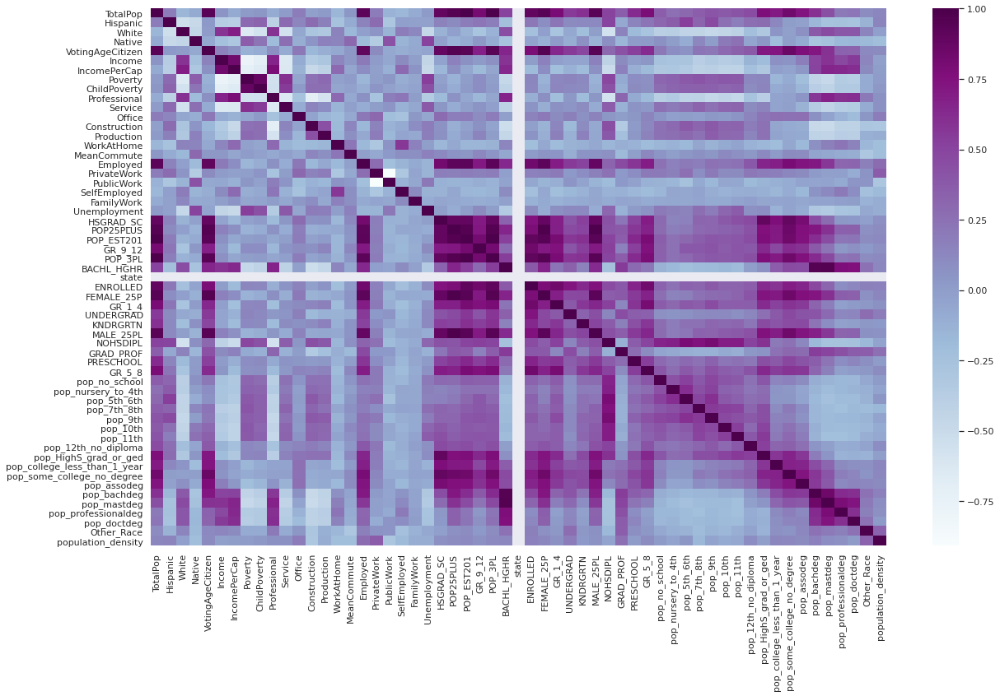

In [ ]:
sns.set()
plt.figure(figsize=(20,12))

sns.heatmap(new_train.corr(), cmap='BuPu', annot=False);

### Counting Head Start locations 

Lets figure out what tracts our Head Start locations are in and count them.

In [ ]:
all_hs_locations.head()

,County,ID,Program Type,Program name,80% Total,Adj%,Funded Slots,Latitude,Longitude,50 Percent Target
0,Lea,123,Head Start,Child and Family Services of Lea County (Washi...,432,59%,92,32.689066,-103.134259,NaN
1,Lea,124,Head Start,Child and Family Services of Lea County (Hillc...,432,59%,32,32.936645,-103.353560,NaN
2,Lea,125,Head Start,Child and Family Services of Lea County (Tieuel),432,59%,133,32.704390,-103.126155,NaN
3,San Miguel,134,Head Start,Eastern Plains CAA (Anton Chico Head Start),268,58%,15,35.220314,-105.168963,NaN
4,Curry,135,Head Start,Eastern Plains CAA (Clovis Head Start),548,26%,140,34.407200,-103.230723,NaN


See how Point from shapely works to verify if a point is in a polygon. Create a point

In [ ]:
p1 = Point(all_hs_locations['Longitude'].iloc[1], all_hs_locations['Latitude'].iloc[1])

We'll use a polygon from our dataframe that has polygons, from the column 'geometry'

In [ ]:
polygon1 = new_train['geometry'].iloc[0]

See if our point(p1) is in the polygon we chose...

In [ ]:
type(polygon1)

shapely.geometry.polygon.Polygon

This says that the chosen polygon does NOT contain the chosen point

In [ ]:
p1.within(polygon1)

False

Below the value x of p1 reflects the longitude of the point


In [ ]:
p1.x

-103.35356

Create a function that returns the tract id IF a point is in any polygon from our census and education data

In [ ]:
def find_census_tract(p1):
  """returns tract id of polygon if point is in that polygon."""
  for i in range(new_train['geometry'].count()):
    polygons = new_train['geometry'].iloc[i]
    if p1.within(polygons) :
      return new_train['Tracts'].iloc[i]


Create a new feature for the tract id on all_hs_locations as => census tract

In [ ]:
#value of -1 was chosen because no id will match it
all_hs_locations['census tract'] = -1

In [ ]:
all_hs_locations.head()

,County,ID,Program Type,Program name,80% Total,Adj%,Funded Slots,Latitude,Longitude,50 Percent Target,census tract
0,Lea,123,Head Start,Child and Family Services of Lea County (Washi...,432,59%,92,32.689066,-103.134259,NaN,-1
1,Lea,124,Head Start,Child and Family Services of Lea County (Hillc...,432,59%,32,32.936645,-103.353560,NaN,-1
2,Lea,125,Head Start,Child and Family Services of Lea County (Tieuel),432,59%,133,32.704390,-103.126155,NaN,-1
3,San Miguel,134,Head Start,Eastern Plains CAA (Anton Chico Head Start),268,58%,15,35.220314,-105.168963,NaN,-1
4,Curry,135,Head Start,Eastern Plains CAA (Clovis Head Start),548,26%,140,34.407200,-103.230723,NaN,-1


Make a for loop that iterates through all_hs_locations and populates the new column with our tract IDs

In [ ]:
for i in range(all_hs_locations['Latitude'].count()):
  p1 = Point(all_hs_locations['Longitude'].iloc[i], all_hs_locations['Latitude'].iloc[i])
  all_hs_locations['census tract'].iloc[i] = find_census_tract(p1)


/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


Note: Tract id's are strings

Create a function that counts the number of Head Start locations for a tract

In [ ]:
def count_head_starts(tract, all_hs_locations):
  """counts how many Head Start locations are in a given tract"""
  return all_hs_locations[all_hs_locations['census tract'] == tract]['census tract'].count()


Test it on a known tract number

In [ ]:
count_head_starts('35025001003', all_hs_locations)

1

Create a new column 'HS_count' on our census and education dataframe with the number of Head Start locations for each tract

In [ ]:
new_train['HS_count'] = new_train['Tracts'].apply(lambda x: count_head_starts(x,all_hs_locations))

In [ ]:
new_train.head(1)

,Tracts,TotalPop,Hispanic,White,Native,VotingAgeCitizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,geometry,HSGRAD_SC,POP25PLUS,POP_EST201,GR_9_12,POP_3PL,BACHL_HGHR,state,ENROLLED,FEMALE_25P,GR_1_4,UNDERGRAD,KNDRGRTN,MALE_25PL,NOHSDIPL,GRAD_PROF,PRESCHOOL,GR_5_8,pop_no_school,pop_nursery_to_4th,pop_5th_6th,pop_7th_8th,pop_9th,pop_10th,pop_11th,pop_12th_no_diploma,pop_HighS_grad_or_ged,pop_college_less_than_1_year,pop_some_college_no_degree,pop_assodeg,pop_bachdeg,pop_mastdeg,pop_professionaldeg,pop_doctdeg,Other_Race,population_density,HS_count
0,35001000107,2473,18.6,73.9,2.7,2048,85750.0,49431.0,7.1,0.0,58.7,9.2,25.6,3.3,3.2,10.2,21.3,1144,78.3,17.4,4.3,0.0,6.2,"POLYGON ((-106.49789 35.13065, -106.49730 35.1...",855,1943,2442,137,2393,1068,35,437,905,74,89,0,1038,20,39,17,81,0,0,0,0,11,9,0,0,347,96,306,106,561,302,90,115,4.8,8.003152e+06,0


####Sum of Funded Slots

Create a function to show the total amount of funded slots per tract 

In [ ]:
def total_enrolled(tract, all_hs_locations):
  """Sums the funded slots of all Head Start locations per tract"""
  return all_hs_locations[all_hs_locations['census tract'] == tract]['Funded Slots'].sum()

Test it out

In [ ]:
total_enrolled('35025000300', all_hs_locations)

111

Use our function to iterate through the whole dataframe and create a new column as => total funded slots

In [ ]:
new_train['total funded slots'] = new_train['Tracts'].apply(lambda x: total_enrolled(x,all_hs_locations))

In [ ]:
new_train.head()

,Tracts,TotalPop,Hispanic,White,Native,VotingAgeCitizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,geometry,HSGRAD_SC,POP25PLUS,POP_EST201,GR_9_12,POP_3PL,BACHL_HGHR,state,ENROLLED,FEMALE_25P,GR_1_4,UNDERGRAD,KNDRGRTN,MALE_25PL,NOHSDIPL,GRAD_PROF,PRESCHOOL,GR_5_8,pop_no_school,pop_nursery_to_4th,pop_5th_6th,pop_7th_8th,pop_9th,pop_10th,pop_11th,pop_12th_no_diploma,pop_HighS_grad_or_ged,pop_college_less_than_1_year,pop_some_college_no_degree,pop_assodeg,pop_bachdeg,pop_mastdeg,pop_professionaldeg,pop_doctdeg,Other_Race,population_density,HS_count,total funded slots
0,35001000107,2473,18.6,73.9,2.7,2048,85750.0,49431.0,7.1,0.0,58.7,9.2,25.6,3.3,3.2,10.2,21.3,1144,78.3,17.4,4.3,0.0,6.2,"POLYGON ((-106.49789 35.13065, -106.49730 35.1...",855,1943,2442,137,2393,1068,35,437,905,74,89,0,1038,20,39,17,81,0,0,0,0,11,9,0,0,347,96,306,106,561,302,90,115,4.8,8.003152e+06,0,0
1,35001000108,3258,23.1,61.2,10.6,2400,63621.0,28099.0,8.1,5.3,41.4,23.8,22.7,7.7,4.3,2.7,24.4,1473,75.6,21.4,3.0,0.0,1.8,"POLYGON ((-106.51571 35.12641, -106.51571 35.1...",1110,2131,3216,73,3093,948,35,695,1244,116,268,11,887,73,6,24,197,0,0,0,0,37,26,0,10,341,119,389,261,721,167,30,30,1.6,2.539021e+07,0,0
2,35001000109,2532,23.0,63.0,10.0,1919,74524.0,32299.0,10.6,24.6,46.2,14.6,25.3,9.1,4.8,4.1,25.2,1122,74.5,18.3,6.6,0.6,13.0,"POLYGON ((-106.53338 35.12822, -106.53333 35.1...",815,1711,2386,139,2285,825,35,485,903,69,95,5,808,71,38,45,94,0,0,11,0,0,24,14,22,345,112,233,125,452,296,62,15,2.0,2.002270e+07,0,0
3,35001000110,3866,33.1,57.4,4.6,3072,35066.0,22567.0,23.6,24.7,33.8,35.5,19.2,7.2,4.2,4.6,21.9,2009,70.5,19.5,10.0,0.0,4.7,"POLYGON ((-106.53329 35.12023, -106.53328 35.1...",1823,2882,4003,170,3963,959,35,873,1529,156,254,22,1353,100,27,52,192,0,0,33,12,0,0,0,55,932,193,462,236,625,205,83,46,2.5,3.024742e+07,0,0
4,35001000111,2994,24.7,61.2,0.0,2241,80000.0,31496.0,8.1,8.2,54.0,15.0,19.4,5.7,5.9,1.5,22.5,1371,64.8,29.0,6.1,0.0,4.1,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",995,2001,2966,201,2830,938,35,873,1096,150,239,12,905,68,70,56,145,9,3,0,0,0,13,32,11,371,94,325,205,588,283,20,47,8.7,2.258354e+07,0,0


In [ ]:
new_train.shape

(498, 61)

In [ ]:
new_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 498 entries, 0 to 497
Data columns (total 61 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   Tracts                        498 non-null    object  
 1   TotalPop                      498 non-null    int64   
 2   Hispanic                      498 non-null    float64 
 3   White                         498 non-null    float64 
 4   Native                        498 non-null    float64 
 5   VotingAgeCitizen              498 non-null    int64   
 6   Income                        498 non-null    float64 
 7   IncomePerCap                  498 non-null    float64 
 8   Poverty                       498 non-null    float64 
 9   ChildPoverty                  498 non-null    float64 
 10  Professional                  498 non-null    float64 
 11  Service                       498 non-null    float64 
 12  Office                        498 non-null    floa

In [ ]:
new_train[new_train['total funded slots'].isna()]

,Tracts,TotalPop,Hispanic,White,Native,VotingAgeCitizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,geometry,HSGRAD_SC,POP25PLUS,POP_EST201,GR_9_12,POP_3PL,BACHL_HGHR,state,ENROLLED,FEMALE_25P,GR_1_4,UNDERGRAD,KNDRGRTN,MALE_25PL,NOHSDIPL,GRAD_PROF,PRESCHOOL,GR_5_8,pop_no_school,pop_nursery_to_4th,pop_5th_6th,pop_7th_8th,pop_9th,pop_10th,pop_11th,pop_12th_no_diploma,pop_HighS_grad_or_ged,pop_college_less_than_1_year,pop_some_college_no_degree,pop_assodeg,pop_bachdeg,pop_mastdeg,pop_professionaldeg,pop_doctdeg,Other_Race,population_density,HS_count,total funded slots


####Head Start Slot Density

Create a variable that contains the column 'total funded slots'

In [ ]:
total_funded_slots = new_train['total funded slots']

Histogram plot of total funded slots per capita.

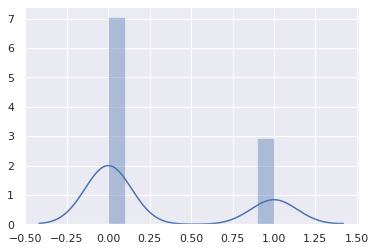

In [ ]:
sns.distplot((new_train['total funded slots']/new_train['TotalPop'])*100000 >0,bins=10);

Create a column of average funded slots per 1000 residents.

In [ ]:
new_train['Slots Per Thousand'] = (new_train['total funded slots']/new_train['TotalPop'])*1000

Store it as a variable

In [ ]:
slots_per_thousand = new_train['Slots Per Thousand']

In [ ]:
slots_per_thousand.head(20)

0      0.000000
1      0.000000
2      0.000000
3      0.000000
4      0.000000
5      0.000000
6      0.000000
7      0.000000
8      0.000000
9      0.000000
10     0.000000
11     0.000000
12     0.000000
13     0.000000
14     0.000000
15    14.528944
16     0.000000
17     0.000000
18     0.000000
19     0.000000
Name: Slots Per Thousand, dtype: float64

###Chosen Features DataFrame

Here we can see our selected features based on demographics and economics.

In [ ]:
chosen_features = pd.DataFrame(new_train['Hispanic'])
chosen_features['White'] = new_train['White']
chosen_features['Native'] = new_train['Native']
chosen_features['Other_Race'] = new_train['Other_Race']
chosen_features['IncomePerCap'] = new_train['IncomePerCap']
chosen_features['ChildPoverty'] = new_train['ChildPoverty']

In [ ]:
chosen_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 498 entries, 0 to 497
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Hispanic      498 non-null    float64
 1   White         498 non-null    float64
 2   Native        498 non-null    float64
 3   Other_Race    498 non-null    float64
 4   IncomePerCap  498 non-null    float64
 5   ChildPoverty  498 non-null    float64
dtypes: float64(6)
memory usage: 23.5 KB


Make another variable for OLS testing

In [ ]:
income_per_cap_only = pd.DataFrame(new_train['IncomePerCap'])


##Data Processing

We explored XGBoost, Kmeans clustering, OLS linear regression, and Hierachical clustering. XGBoost was useful for seeing the feature importances, but we ended up going with Hierachical clustering with robust scaling for our final output.

###XGBoost

Feature importance WITH 'ChildPoverty' included.

In [ ]:
xgbr = xgb.XGBRegressor(verbosity=0)
xgbr.fit(chosen_features,total_funded_slots)
y_prediction = xgbr.predict(chosen_features)
feature_imp = pd.Series(xgbr.feature_importances_,index=chosen_features.columns)

Text(0, 0.5, 'feature importance score')

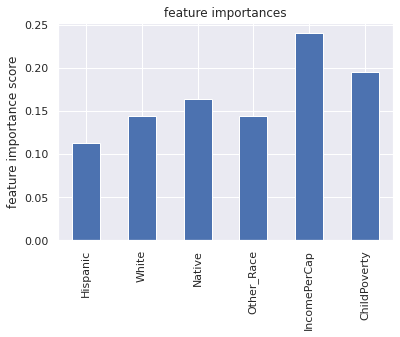

In [ ]:

feature_imp.plot(kind='bar',title='feature importances');
plt.ylabel('feature importance score')

Show the cross validation accuracy

In [ ]:
kfold = KFold(n_splits=10, random_state=7)
results = cross_val_score(xgbr, chosen_features, total_funded_slots, cv=kfold)
print("Accuracy: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:296: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  FutureWarning


Accuracy: -64.43% (146.66%)


Feature importance WITHOUT 'ChildPoverty'

In [ ]:
chosen_features_no_poverty = chosen_features.drop(['ChildPoverty'],axis=1).copy()

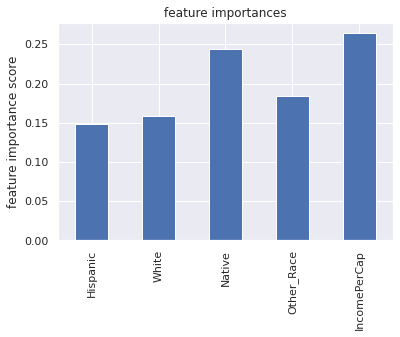

In [ ]:
xgbr = xgb.XGBRegressor(verbosity=0)
xgbr.fit(chosen_features_no_poverty,total_funded_slots)
y_prediction = xgbr.predict(chosen_features_no_poverty)
feature_imp = pd.Series(xgbr.feature_importances_,index=chosen_features_no_poverty.columns)
feature_imp.plot(kind='bar',title='feature importances');
plt.ylabel('feature importance score');

Feature importance where total funded slots is > 0

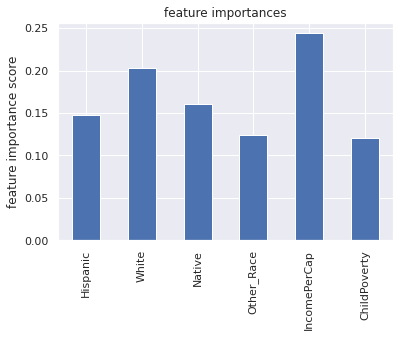

In [ ]:
xgbr = xgb.XGBRegressor(verbosity=0)
xgbr.fit(chosen_features[total_funded_slots>0],total_funded_slots[total_funded_slots>0])
y_prediction = xgbr.predict(chosen_features[total_funded_slots>0])
feature_imp = pd.Series(xgbr.feature_importances_,index=chosen_features[total_funded_slots>0].columns)
feature_imp.plot(kind='bar',title='feature importances');
plt.ylabel('feature importance score');

###Robust Scaling

Use robust scaling on our chosen features dataframe.

In [ ]:
scaler = preprocessing.RobustScaler()
chosen_feats_robust = scaler.fit_transform(chosen_features)
chosen_feats_robust = pd.DataFrame(chosen_feats_robust, columns=chosen_features.columns)

####Correlation of chosen features

Check the correlation of our scaled data.

In [ ]:
chosen_corr = chosen_feats_robust.copy()

In [ ]:
chosen_corr['total funded slots'] = total_funded_slots

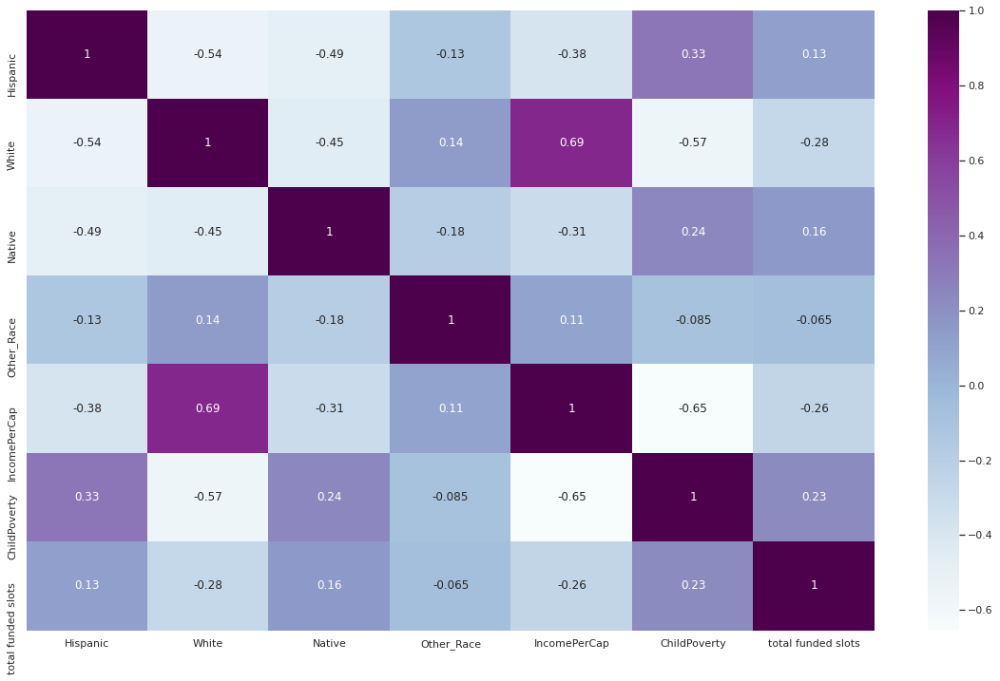

In [ ]:
sns.set()
plt.figure(figsize=(20,12))

sns.heatmap(chosen_corr.corr(), cmap='BuPu', annot=True);

###OLS

Investigate our data using ordinary least squares linear regression.

In [ ]:
chosen_feats_robust.head()

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty
0,-0.757851,0.992614,0.219780,0.833333,2.017172,-0.942486
1,-0.632240,0.617430,1.956044,-0.055556,0.381878,-0.745826
2,-0.635031,0.670606,1.824176,0.055556,0.703846,-0.029685
3,-0.353105,0.505170,0.637363,0.194444,-0.042201,-0.025974
4,-0.587579,0.617430,-0.373626,1.916667,0.642289,-0.638219


In [ ]:
X = chosen_feats_robust[total_funded_slots > 0] 
#add 1's column for our y-intercept
X['Ones'] = 1
y = total_funded_slots[total_funded_slots > 0] 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
X.head()

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,Ones
15,-0.216329,0.336780,-0.241758,1.694444,0.692654,-0.504638,1
29,-0.685276,0.706056,0.571429,1.388889,1.457483,-0.359926,1
33,-0.621075,0.744461,0.043956,0.722222,0.931218,-0.638219,1
34,-0.333566,0.319055,0.043956,2.638889,0.111654,-0.512059,1
35,0.707606,-0.703102,1.802198,0.194444,-0.865674,1.339518,1


In [ ]:
y.head()

15    64
29    72
33    20
34    57
35    59
Name: total funded slots, dtype: int64

In [ ]:
model = sm.OLS(y,X).fit()
predictions = model.predict(X)
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     total funded slots   R-squared:                       0.188
Model:                            OLS   Adj. R-squared:                  0.153
Method:                 Least Squares   F-statistic:                     5.393
Date:                Wed, 23 Sep 2020   Prob (F-statistic):           4.85e-05
Time:                        15:42:52   Log-Likelihood:                -784.26
No. Observations:                 147   AIC:                             1583.
Df Residuals:                     140   BIC:                             1603.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
================================================================================
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Hispanic       -16.5503    104.615     -0.158      0.875    -223.379     190.278
White          -22.4739    102.474     -0.219      0.827    -225.070     180.122
Native           1.0212     13.512      0.076      0.940     -25.692      27.735
Other_Race      10.5324     12.902      0.816      0.416     -14.975      36.040
IncomePerCap   -15.7789     11.775     -1.340      0.182     -39.059       7.501
ChildPoverty     6.3721      9.983      0.638      0.524     -13.365      26.110
Ones            51.8448     26.650      1.945      0.054      -0.843     104.533
==============================================================================
Omnibus:                       59.434   Durbin-Watson:                   2.019
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              149.238
Skew:                           1.697   Prob(JB):                     3.92e-33
Kurtosis:                       6.584   Cond. No.                         193.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

**Our 'R-squared' value above is not great nor do we see a linear trend in the scatter plot below. OLS is not the preffered model for this project.**

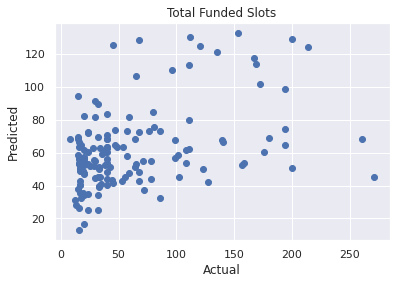

In [ ]:
plt.scatter(y,predictions);
plt.title('Total Funded Slots');
plt.ylabel('Predicted');
plt.xlabel('Actual');

###OLS income per cap only

Investigate our data using ordinary least squares linear regression.

In [ ]:
scaler = preprocessing.RobustScaler()
income_per_cap_only_robust = scaler.fit_transform(income_per_cap_only)
income_per_cap_only_robust = pd.DataFrame(income_per_cap_only_robust, columns=income_per_cap_only.columns)

In [ ]:
income_per_cap_only.head()

,IncomePerCap
0,49431.0
1,28099.0
2,32299.0
3,22567.0
4,31496.0


In [ ]:
X = income_per_cap_only_robust[total_funded_slots > 0] 
#add 1's column for our y-intercept
X['Ones'] = 1
y = total_funded_slots[total_funded_slots > 0] 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
X.head()

,IncomePerCap,Ones
15,0.692654,1
29,1.457483,1
33,0.931218,1
34,0.111654,1
35,-0.865674,1


In [ ]:
y.head()

15    64
29    72
33    20
34    57
35    59
Name: total funded slots, dtype: int64

In [ ]:
model = sm.OLS(y,X).fit()
predictions = model.predict(X)
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     total funded slots   R-squared:                       0.091
Model:                            OLS   Adj. R-squared:                  0.084
Method:                 Least Squares   F-statistic:                     14.47
Date:                Wed, 23 Sep 2020   Prob (F-statistic):           0.000209
Time:                        15:42:52   Log-Likelihood:                -792.55
No. Observations:                 147   AIC:                             1589.
Df Residuals:                     145   BIC:                             1595.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
================================================================================
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
IncomePerCap   -30.9281      8.130     -3.804      0.000     -46.996     -14.860
Ones            56.4580      4.626     12.205      0.000      47.315      65.601
==============================================================================
Omnibus:                       47.076   Durbin-Watson:                   1.911
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               86.309
Skew:                           1.514   Prob(JB):                     1.81e-19
Kurtosis:                       5.217   Cond. No.                         1.92
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

**Our 'R-squared' value above is not great nor do we see a linear trend in the scatter plot below. OLS is not the preffered model for this project.**

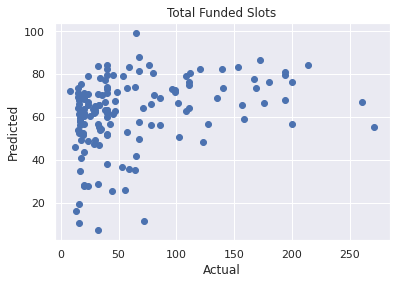

In [ ]:
plt.scatter(y,predictions);
plt.title('Total Funded Slots');
plt.ylabel('Predicted');
plt.xlabel('Actual');

###Kmeans Clustering

In [ ]:
#Use 6 clusters from the elbow method below
kmeans_clusters = KMeans(n_clusters=6).fit(chosen_feats_robust)

In [ ]:
y_pred = kmeans_clusters.predict(chosen_feats_robust)

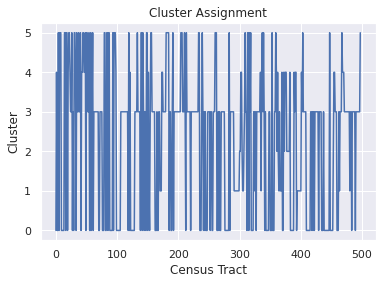

In [ ]:
plt.plot(y_pred);
plt.title('Cluster Assignment');
plt.ylabel('Cluster');
plt.xlabel('Census Tract');

####Elbow Method

Use the elbow method to discover the ideal amount of clusters

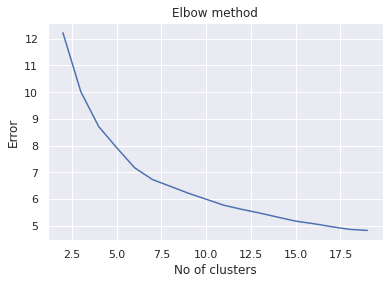

In [ ]:
Error =[]
for i in range(2, 20):
    kmeans = KMeans(n_clusters = i).fit(chosen_feats_robust)
    kmeans.fit(chosen_feats_robust)
    Error.append(kmeans.inertia_)

cluster_size = np.sqrt(np.array(Error)/len(Error))    
plt.plot(range(2, 20), cluster_size)
plt.title('Elbow method')
plt.xlabel('No of clusters')
plt.ylabel('Error')
plt.show()

no elbow... it does look like it hits lower error at around 6 clusters though.


In [ ]:
kmeans.labels_


array([ 5,  6,  6,  2,  9,  5,  2,  2, 12,  0,  0, 13,  5,  2,  9,  9, 14,
       12,  9,  2,  6,  2,  7,  6,  2,  2,  9,  2,  3,  9,  9,  9, 15,  5,
        9, 15, 15,  2, 17,  2,  9,  0, 15, 12,  7,  7, 15, 12, 17, 13,  2,
       12, 16, 16,  9,  2,  0, 12,  9, 15, 12, 13, 16, 16, 17,  3,  2, 14,
        3,  3, 13,  5, 14,  3, 15, 14, 11, 14, 13,  9,  2, 11, 13,  9,  9,
       11,  9,  9,  5,  0,  5,  0, 11,  9, 11,  7, 12,  9, 15, 11,  6,  5,
        5, 13,  5,  0, 16, 16, 16, 16, 16, 16,  3,  2, 16, 16, 16, 16,  2,
        2,  9,  6, 13, 13, 14,  2, 14,  9,  2, 16, 16, 16, 15, 17, 16, 17,
       16, 16,  2,  9,  9, 13,  2,  2, 14, 15,  2, 13,  9,  9, 11,  8,  1,
        0, 14, 17,  2, 14,  3, 16, 14,  3, 14,  0,  0,  3,  0, 14, 14, 14,
       10,  1, 10,  8,  8, 15,  2, 14,  3,  3, 17,  9, 17,  9,  9,  9,  3,
        3,  0,  5,  3,  7, 14,  3,  3, 14, 16, 14,  2, 16,  3,  3, 16,  3,
       17, 17, 17, 14, 14, 16,  9,  3, 11,  9,  3, 16,  3, 14, 14, 16, 13,
       16, 16, 14, 16, 16

###Hierarachical Clustering

Normalize (scale) the data

In [ ]:
#use the Robust Scaling from before
train_scaled = chosen_feats_robust

####Dendrogram

Create dendrogram of the clustering.

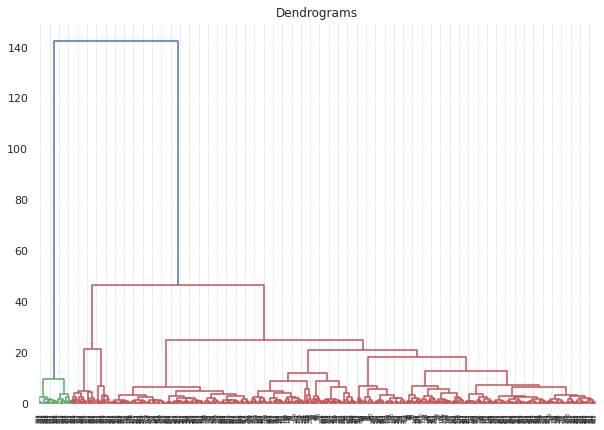

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms")  
dend = shc.dendrogram(shc.linkage(train_scaled, method='ward'))

Choose an appropriate threshold for the clusters.


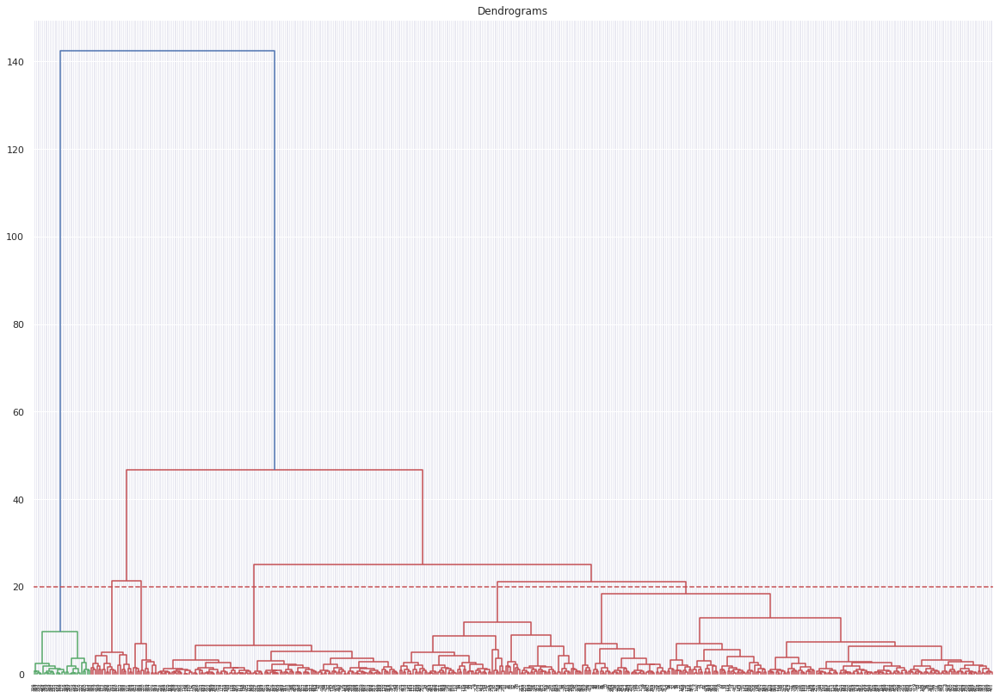

In [ ]:
plt.figure(figsize=(20, 14));  
plt.title("Dendrograms");  
dend = shc.dendrogram(shc.linkage(train_scaled, method='ward'));
plt.axhline(y=20, color='r', linestyle='--');

We can see there are 6 clusters based off of the threshold we chose above.

Classify all points based on the number of clusters at the threshold you chose.

In [ ]:
cluster = AgglomerativeClustering(n_clusters=6, affinity='euclidean', linkage='ward')  
clusterNums = pd.Series(cluster.fit_predict(train_scaled))

Visualizing the clusters.

In [ ]:
train_scaled.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty
0,-0.757851,0.992614,0.21978,0.833333,2.017172,-0.942486



**Which features are important here?**

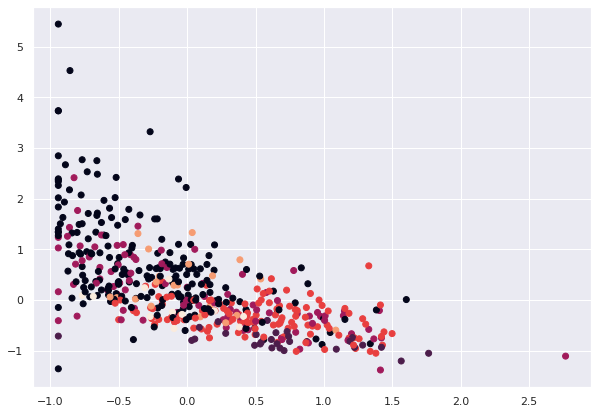

In [ ]:
plt.figure(figsize=(10, 7));  
plt.scatter(chosen_feats_robust['ChildPoverty'], chosen_feats_robust['IncomePerCap'], c=cluster.labels_); 

We can see below that if we don't use scaling the x and y values get out of hand.

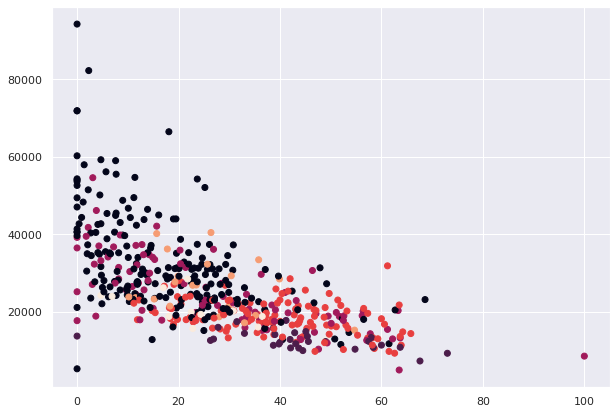

In [ ]:
plt.figure(figsize=(10, 7));  
plt.scatter(chosen_features['ChildPoverty'], chosen_features['IncomePerCap'], c=cluster.labels_); 

####Principal Components Analysis

PCA shows us the features that had the most impact on clustering.

In [ ]:
pca = PCA(n_components=4)
pca_result = pca.fit_transform(train_scaled)

In [ ]:
eVectors = pca.components_
eVectors[2,]

array([-0.00820981, -0.10913791,  0.01115392,  0.95700473, -0.22537072,
        0.14576384])

Above we can see that the 4th feature had the highest impact on clustering.

In [ ]:
train_scaled.columns

Index(['Hispanic', 'White', 'Native', 'Other_Race', 'IncomePerCap',
       'ChildPoverty'],
      dtype='object')

Find variance explained with each principal component.

In [ ]:
pca_df = pd.DataFrame(columns = ['pca1','pca2','pca3','pca4'])

pca_df['pca1'] = pca_result[:,0]
pca_df['pca2'] = pca_result[:,1]
pca_df['pca3'] = pca_result[:,2]
pca_df['pca4'] = pca_result[:,3]

print('Variance explained per principal component: {}'.format(pca.explained_variance_ratio_))

Variance explained per principal component: [0.89863354 0.05126505 0.03372497 0.00927026]


Below shows the importance of each feature, per component, starting with the most important component.

In [ ]:
pca.components_

array([[-0.06442472, -0.06098121,  0.99305234, -0.03794716, -0.05842505,
         0.03353101],
       [-0.43626138,  0.41326115,  0.05800618,  0.25457033,  0.63930507,
        -0.40250402],
       [-0.00820981, -0.10913791,  0.01115392,  0.95700473, -0.22537072,
         0.14576384],
       [-0.5406185 ,  0.57528224, -0.04324053, -0.10402706, -0.42707409,
         0.42626088]])

Visualize clustering in top two principal components.

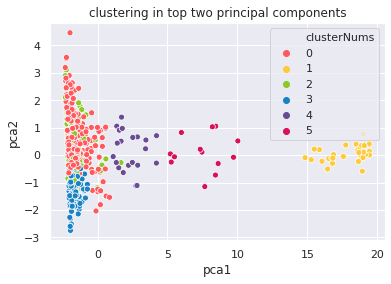

In [ ]:
top_two_comp = pca_df[['pca1','pca2']] # taking first and second principal component
comp_DF = pd.concat([top_two_comp, clusterNums],axis=1)
comp_DF.columns = ['pca1','pca2','clusterNums']

g =sns.scatterplot(x="pca1", y="pca2", hue="clusterNums",
                   data=comp_DF,palette=['#ff595e','#ffca3a','#8ac926','#1982c4','#6a4c93','#d81159']).set_title('clustering in top two principal components');

####Visualize with t-SNE

t-Distributed Stochastic Neighbor Embedding

In [ ]:
comp_tsne = TSNE(random_state=123).fit_transform(train_scaled)

Create your Data Frame with the t-SNE coordinates and cluster IDs.

In [ ]:
tsne_DF = pd.concat([pd.DataFrame(comp_tsne), clusterNums],axis=1)
tsne_DF.columns = ['dim1','dim2','clusterNums']
tsne_DF.head()

,dim1,dim2,clusterNums
0,25.640528,2.151941,0
1,-8.150176,9.122035,0
2,-7.945575,9.939355,0
3,-2.548141,3.440174,0
4,13.547338,8.791371,2


Visualize the clusters

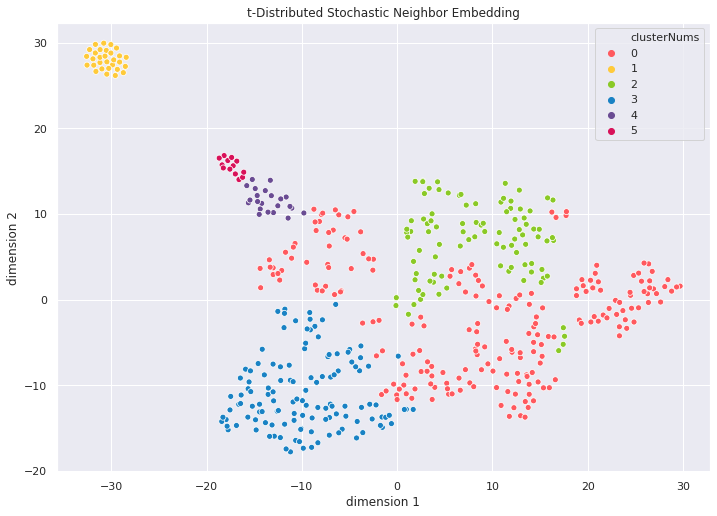

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)});
g =sns.scatterplot(x="dim1", y="dim2", hue="clusterNums",
                   data=tsne_DF,palette=['#ff595e','#ffca3a','#8ac926','#1982c4','#6a4c93','#d81159']).set_title('t-Distributed Stochastic Neighbor Embedding');
plt.xlabel('dimension 1');
plt.ylabel('dimension 2');

In [ ]:
cluster_centers = cluster
cluster = chosen_features.copy()

In [ ]:
cluster['cluster'] = tsne_DF['clusterNums']
cluster['HS_count'] = new_train['HS_count']
cluster['total funded slots'] = total_funded_slots
cluster['Slots Per Thousand'] = slots_per_thousand

Let's take a quick look at all the tracts that are in cluster 0.

In [ ]:
cluster[cluster['cluster']==0]

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand
0,18.6,73.9,2.7,4.8,49431.0,0.0,0,0,0,0.000000
1,23.1,61.2,10.6,1.6,28099.0,5.3,0,0,0,0.000000
2,23.0,63.0,10.0,2.0,32299.0,24.6,0,0,0,0.000000
3,33.1,57.4,4.6,2.5,22567.0,24.7,0,0,0,0.000000
5,22.8,71.0,0.8,3.5,40581.0,7.4,0,0,0,0.000000
...,...,...,...,...,...,...,...,...,...,...
490,55.1,37.2,5.6,0.9,21683.0,20.4,0,1,40,6.108735
493,60.7,37.0,0.0,2.4,20827.0,29.5,0,1,20,9.620010
494,48.3,47.4,2.6,0.6,23067.0,27.1,0,0,0,0.000000
496,43.1,51.9,1.4,1.5,16140.0,18.9,0,0,0,0.000000


Looking at just the no. 2 cluster...

In [ ]:
cluster[cluster['cluster']==2].shape

(95, 10)

In [ ]:
cluster[cluster['cluster']==2].head()

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand
4,24.7,61.2,0.0,8.7,31496.0,8.2,2,0,0,0.000000
8,32.9,44.8,6.4,12.5,19075.0,56.2,2,0,0,0.000000
14,34.0,52.2,1.2,8.3,24558.0,33.4,2,0,0,0.000000
15,38.0,51.7,0.6,7.9,32153.0,11.8,2,2,64,14.528944
17,39.6,36.1,9.0,11.8,24018.0,28.8,2,0,0,0.000000


####Pivot Table

Lets make a pivot table, indexed by the clusters we have created. The table shows the average values for each feature, per cluster.

In [ ]:
table = pd.pivot_table(cluster, index='cluster')

In [ ]:
table

,ChildPoverty,HS_count,Hispanic,IncomePerCap,Native,Other_Race,Slots Per Thousand,White,total funded slots
cluster,,,,,,,,,
0,18.399531,0.225352,38.657746,32127.089202,2.961972,2.224883,2.756525,54.264789,9.525822
1,43.976667,0.500000,4.886667,12719.933333,90.003333,0.770000,12.649758,2.973333,43.666667
2,27.535789,0.305263,42.963158,25027.105263,2.100000,8.284211,3.705764,44.035789,14.378947
3,38.560800,0.704000,74.400800,18800.272000,1.368800,1.216800,6.455212,22.118400,27.256000
4,25.900000,0.772727,38.736364,26321.863636,19.700000,2.236364,7.323182,37.136364,29.045455
5,26.100000,0.538462,26.976923,19812.846154,43.453846,1.061538,9.153905,26.176923,25.153846


Looking at the pivot table above, we can see that the clusters (2 and 3) that have a higher amount of Hispanics tend to have higher child poverty with lower total funded slots. While cluster 1 has the highest child poverty, it also has the highest average of funded slots. Cluster 0 has the lowest child poverty, which reflects the low amount of slots and average head start locations. It becomes clear that the Hispanic demographic in New Mexico is underserved compared to the others.

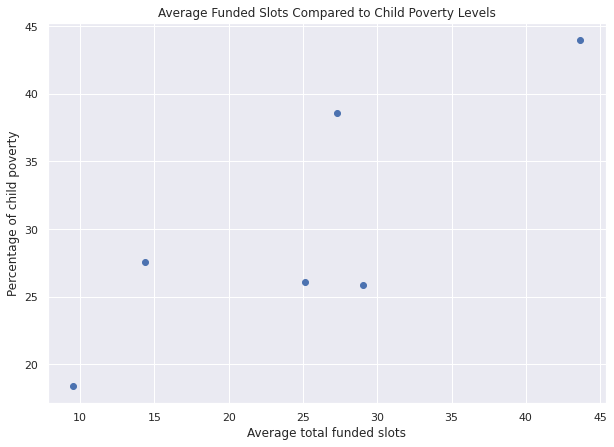

In [ ]:
plt.figure(figsize=(10, 7));  
plt.scatter(table['total funded slots'], table['ChildPoverty']); 
plt.ylabel('Percentage of child poverty');
plt.xlabel('Average total funded slots');
plt.title('Average Funded Slots Compared to Child Poverty Levels');

In [ ]:
cluster_original = cluster.copy()

#### Cluster 2 DataFrame

Cluster 2 appears to be underserved, where higher child poverty corresponds with very low numbers of funded slots on average as well as a low number of Head Start locations. We will take a closer look at this data and create a dataframe that contains the tracts that are below the average income per capita for this cluster. 

In [ ]:
cluster_two_below_average = cluster[cluster['cluster']==2]

In [ ]:
cluster_two_below_average = cluster_two_below_average[cluster_two_below_average['IncomePerCap']<24000]

In [ ]:
cluster_two_below_average.shape

(48, 10)

####Cluster 3 DataFrame

Similar to cluster 2 it appears that cluster 3 is underserved as well and also has a much higher child poverty percentage that corresponds to lower total funded slots. We will make another dataframe that only has tracts from cluster 3 that are below average income per capita for that cluster.

In [ ]:
cluster_three_below_average = cluster[cluster['cluster']==3]

In [ ]:
cluster_three_below_average.shape

(125, 10)

In [ ]:
cluster_three_below_average = cluster_three_below_average[cluster_three_below_average['IncomePerCap']<18000]


In [ ]:
cluster_three_below_average.head()

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand
36,65.1,23.9,5.9,2.8,16528.0,36.2,3,1,8,1.912960
52,89.6,4.3,3.1,1.8,13632.0,44.5,3,1,24,5.656375
53,79.8,14.1,1.8,3.2,15850.0,26.7,3,1,140,55.335968
106,81.7,16.5,0.3,1.1,16207.0,51.1,3,1,40,7.163324
107,80.8,14.0,2.5,2.0,16859.0,60.6,3,1,15,2.798507


In [ ]:
cluster_three_below_average.shape

(53, 10)

##Data Visualization

###All Clusters Map

For this visualization we will add back in the "Tracts" and "geometry" columns from new_train.

In [ ]:
cluster['geometry'] = new_train['geometry']
cluster['Tract Name'] = tract_names
cluster['Total Population'] = new_train['TotalPop']
cluster['County'] = counties

In [ ]:
cluster['geometry'].isna().unique()

array([False])

In [ ]:
map_df = geopandas.GeoDataFrame(cluster)

In [ ]:
map_df.index.name = 'id'
map_df.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County
id,,,,,,,,,,,,,,
0,18.6,73.9,2.7,4.8,49431.0,0.0,0,0,0,0.0,"POLYGON ((-106.49789 35.13065, -106.49730 35.1...",1.07,2473,Bernalillo County


In [ ]:
colors = pd.Series()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  """Entry point for launching an IPython kernel.


In [ ]:
colors = map_df['cluster'].copy()

In [ ]:
colors.head(2)

id
0    0
1    0
Name: cluster, dtype: int64

In [ ]:
colors.shape

(498,)

For the sake of consistency we are going to set which colors will be attributed to which clusters once and after this point any visualization that contains all six clusters will use these colors.


In [ ]:
colors[colors==0] ='#ff595e'
colors[colors==1] ='#ffca3a'
colors[colors==2] ='#8ac926'
colors[colors==3] ='#1982c4'
colors[colors==4] ='#6a4c93'
colors[colors==5] ='#d81159'

Rename the index column

In [ ]:
colors.index.name = 'id'

In [ ]:
colors.head(10)

id
0    #ff595e
1    #ff595e
2    #ff595e
3    #ff595e
4    #8ac926
5    #ff595e
6    #ff595e
7    #ff595e
8    #8ac926
9    #ff595e
Name: cluster, dtype: object

In [ ]:
colors.shape

(498,)

In [ ]:
colors[0]

'#ff595e'

Let's take a quick count of how many tracts are in cluster 0.

In [ ]:
colors[colors=='#ff595e'].count()

213

Change the zero cluster to be called Cluster 6 for presentation purposes.

In [ ]:
map_df.loc[map_df['cluster'] == 0, 'cluster'] = 6
map_df['cluster'].unique()

array([6, 2, 3, 4, 1, 5])

Lets take all the Head Start locations and turn them into a numpy array, then we will use the array to drop pins on our map.

In [ ]:
# zip x and y coordinates into single feature
head_start_locations = np.array([all_hs_locations['Latitude'], all_hs_locations['Longitude']]).T

In [ ]:
type(head_start_locations)

numpy.ndarray

#####Minimum distance to Head Start

The haversine formula determines the great-circle distance between two points on a sphere given their longitudes and latitudes. Here we define the haversine function so we can measure the distance to the nearest Head Start location from the center of each polygon.

In [ ]:
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance (miles) between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 3956 # Radius of earth in miles. Use 6371 for kilometers
    return c * r

Create a centroid column for each census tract. These will make the coordinates for the second argument in our haversine function.

In [ ]:
map_df['centroids'] = map_df['geometry'].apply(lambda x: x.centroid)

Create a function to calculate the **minimum** distance (in miles) to a head start center from a given centroid.

In [ ]:
def calculate_min_to_hs(centroid, hs_locations) :
  distances = []
  for hs in range(hs_locations.shape[0]) :
    distances.append(haversine(hs_locations.iloc[hs]['Longitude'],
                               hs_locations.iloc[hs]['Latitude'],
                               centroid.x,
                               centroid.y))
  return round(min(distances),2)

Test it out.

In [ ]:
calculate_min_to_hs(map_df.iloc[0]['centroids'], all_hs_locations)

3.73

Apply this function to the whole dataframe and create the 'nearest headstart' column.

In [ ]:
map_df['nearest headstart'] = map_df['centroids'].apply(lambda x : calculate_min_to_hs(x, all_hs_locations))

Drop the 'centroids' column as we no longer need it. Also, folium does not agree with this data.

In [ ]:
map_df.drop('centroids', axis=1, inplace=True)

Review our new column.

In [ ]:
map_df.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
0,18.6,73.9,2.7,4.8,49431.0,0.0,6,0,0,0.0,"POLYGON ((-106.49789 35.13065, -106.49730 35.1...",1.07,2473,Bernalillo County,3.73


In [ ]:
map_df_original = map_df.copy()

#####Map

In order to better communicate our data we are going to create an interactive map that will show you a few things...
- all of the census tracts in New Mexico 
- which cluster each tract belongs to
- all Head Start and Early Head Start locations
- some of the demographics for the census tracts


In [ ]:
nm_map = folium.Map(location=[34.5199, -105.8701],zoom_start=7, control_scale=True,
                        tiles='CartoDB positron'   
                        )
census_layer = folium.GeoJson(
    map_df,
    name='Census Tracts',
    style_function=lambda feature: {
        'fillColor': colors[int(feature['id'])],
        'color':'black',
        'weight':1,
        'fillOpacity':.5
    }
    ,
    tooltip=folium.GeoJsonTooltip(
        fields=['Native', 'Hispanic', 'White', 'Other_Race', 'Total Population', 'IncomePerCap', 'nearest headstart', 'ChildPoverty', 'total funded slots', 'cluster', 'County', 'Tract Name'],
        aliases=['Native', 'Hispanic', 'White', 'Other Race', 'Total Population', 'IncomePerCap', 'Nearest Head Start (Miles)', 'Child Poverty', 'Total Funded Slots', 'Cluster', 'County', 'Tract Name']
    ) 
)


#add pins to the map for each Head Start location
hs_group = FeatureGroup(name='Head Starts')
for location in head_start_locations:
  marker = folium.Marker(location,
  popup="Head Start Center",
  icon=folium.Icon(color='blue', icon='child', prefix='fa')) 
  marker.add_to(hs_group)

hs_group.add_to(nm_map)
census_layer.add_to(nm_map)
folium.LayerControl().add_to(nm_map)


nm_map

###Cluster 2

Now that we have an idea of all of the census tracts and clusters let's take a closer look at the two clusters that seem to need the most attention. First up, cluster 2. 

Add polygons and tract ids into our dataframe for mapping.

In [ ]:
cluster_2 = map_df_original[map_df_original['cluster']==2].copy()
cluster_3 = map_df_original[map_df_original['cluster']==3].copy()

In [ ]:
cluster_2['geometry'] = new_train['geometry']
cluster_2['Tract Name'] = tract_names
cluster_2['Total Population'] = new_train['TotalPop']
cluster_2['County'] = counties
cluster_2.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
4,24.7,61.2,0.0,8.7,31496.0,8.2,2,0,0,0.0,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",1.11,2994,Bernalillo County,2.69


This code can be uncommented if you want to see just the cluster tracts that are below average for their cluster.

In [ ]:
# cluster_two_below_average['geometry'] = new_train['geometry']
# cluster_two_below_average['Tract Name'] = tract_names
# cluster_two_below_average['Total Population'] = new_train['TotalPop']
# cluster_two_below_average['County'] = counties
# cluster_two_below_average.head(1)

In [ ]:
#cluster_two_below_average.info()
cluster_2.info()


<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 95 entries, 4 to 475
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Hispanic            95 non-null     float64 
 1   White               95 non-null     float64 
 2   Native              95 non-null     float64 
 3   Other_Race          95 non-null     float64 
 4   IncomePerCap        95 non-null     float64 
 5   ChildPoverty        95 non-null     float64 
 6   cluster             95 non-null     int64   
 7   HS_count            95 non-null     int64   
 8   total funded slots  95 non-null     int64   
 9   Slots Per Thousand  95 non-null     float64 
 10  geometry            95 non-null     geometry
 11  Tract Name          95 non-null     object  
 12  Total Population    95 non-null     int64   
 13  County              95 non-null     object  
 14  nearest headstart   95 non-null     float64 
dtypes: float64(8), geometry(1), int64

Now we will use the cluster_two_below_average dataframe to create a new dataframe called map_df.

In [ ]:
map_df = geopandas.GeoDataFrame(cluster_2)
map_df.index.name = 'id'
map_df.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
4,24.7,61.2,0.0,8.7,31496.0,8.2,2,0,0,0.0,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",1.11,2994,Bernalillo County,2.69


In [ ]:
colors = pd.Series()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  """Entry point for launching an IPython kernel.


In [ ]:
colors = map_df['cluster'].copy()

In [ ]:
colors.shape

(95,)

In [ ]:
colors[colors==2] ='#8ac926'

Rename the index column

In [ ]:
colors.index.name = 'id'
colors.head(10)

id
4     #8ac926
8     #8ac926
14    #8ac926
15    #8ac926
17    #8ac926
21    #8ac926
22    #8ac926
26    #8ac926
29    #8ac926
30    #8ac926
Name: cluster, dtype: object

In [ ]:
colors.shape

(95,)

Lets take all the Head Start locations and turn them into a numpy array, then we will use the array to drop pins on our map.

In [ ]:
# zip x and y coordinates into single feature
head_start_locations = np.array([all_hs_locations['Latitude'], all_hs_locations['Longitude']]).T

In [ ]:
type(head_start_locations)

numpy.ndarray

Add Head Start distances

In [ ]:
map_df['centroids'] = map_df['geometry'].apply(lambda x: x.centroid)

In [ ]:
map_df['nearest headstart'] = map_df['centroids'].apply(lambda x : calculate_min_to_hs(x, all_hs_locations))

In [ ]:
map_df.drop('centroids', axis=1, inplace=True)

In [ ]:
map_df.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
4,24.7,61.2,0.0,8.7,31496.0,8.2,2,0,0,0.0,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",1.11,2994,Bernalillo County,2.69


#####Cluster 2 Map

This map will show only data for all of the tracts in cluster 2. 

In [ ]:
nm_map = folium.Map(location=[34.5199, -105.8701],zoom_start=7, control_scale=True,
                        tiles='CartoDB positron'   
                        )
census_layer = folium.GeoJson(
    map_df,
    name='Census Tracts',
    style_function=lambda feature: {
        'fillColor': colors[int(feature['id'])],
        'color':'black',
        'weight':1,
        'fillOpacity':.5
    }
    ,
    tooltip=folium.GeoJsonTooltip(
        fields=['Native', 'Hispanic', 'White', 'Other_Race', 'Total Population', 'IncomePerCap', 'nearest headstart', 'ChildPoverty', 'total funded slots', 'cluster', 'County', 'Tract Name'],
        aliases=['Native', 'Hispanic', 'White', 'Other Race', 'Total Population', 'IncomePerCap', 'Nearest Head Start (Miles)', 'Child Poverty', 'Total Funded Slots', 'Cluster', 'County', 'Tract Name']
    ) 
)


#add pins to the map for each Head Start location
hs_group = FeatureGroup(name='Head Starts')
for location in head_start_locations:
  marker = folium.Marker(location,
  popup="Head Start Center",
  icon=folium.Icon(color='blue', icon='child', prefix='fa')) 
  marker.add_to(hs_group)

hs_group.add_to(nm_map)
census_layer.add_to(nm_map)
folium.LayerControl().add_to(nm_map)

nm_map

###Cluster 3

Now we will do the same for the below average tracts for cluster 3.



In [ ]:
cluster_3['geometry'] = new_train['geometry']
cluster_3['Tract Name'] = tract_names
cluster_3['Total Population'] = new_train['TotalPop']
cluster_3['County'] = counties
cluster_3.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
28,62.8,32.7,3.3,0.0,23108.0,40.0,3,0,0,0.0,"POLYGON ((-106.60421 35.10565, -106.60419 35.1...",2.08,2942,Bernalillo County,1.83


Uncomment to map below average income tracts for cluster 3

In [ ]:
# cluster_three_below_average['geometry'] = new_train['geometry']
# cluster_three_below_average['Tract Name'] = tract_names
# cluster_three_below_average['Total Population'] = new_train['TotalPop']
# cluster_three_below_average['County'] = counties
# cluster_three_below_average.head(1)

In [ ]:
#cluster_three_below_average.info()
cluster_3.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 125 entries, 28 to 495
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Hispanic            125 non-null    float64 
 1   White               125 non-null    float64 
 2   Native              125 non-null    float64 
 3   Other_Race          125 non-null    float64 
 4   IncomePerCap        125 non-null    float64 
 5   ChildPoverty        125 non-null    float64 
 6   cluster             125 non-null    int64   
 7   HS_count            125 non-null    int64   
 8   total funded slots  125 non-null    int64   
 9   Slots Per Thousand  125 non-null    float64 
 10  geometry            125 non-null    geometry
 11  Tract Name          124 non-null    object  
 12  Total Population    125 non-null    int64   
 13  County              124 non-null    object  
 14  nearest headstart   125 non-null    float64 
dtypes: float64(8), geometry(1), int

In [ ]:
cluster_3['geometry'].isna().unique()

array([False])

In [ ]:
map_df = geopandas.GeoDataFrame(cluster_3)
map_df.index.name = 'id'
map_df.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
28,62.8,32.7,3.3,0.0,23108.0,40.0,3,0,0,0.0,"POLYGON ((-106.60421 35.10565, -106.60419 35.1...",2.08,2942,Bernalillo County,1.83


In [ ]:
colors = pd.Series()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  """Entry point for launching an IPython kernel.


In [ ]:
colors = map_df['cluster'].copy()
colors.shape

(125,)

Define what color you want the polygons to be on the map.

In [ ]:
colors[colors==3] ='#1982c4'

Rename the index column

In [ ]:
colors.index.name = 'id'

In [ ]:
colors.shape

(125,)

Lets take all the Head Start locations and turn them into a numpy array, then we will use the array to drop pins on our map.

In [ ]:
# zip x and y coordinates into single feature
head_start_locations = np.array([all_hs_locations['Latitude'], all_hs_locations['Longitude']]).T

In [ ]:
type(head_start_locations)

numpy.ndarray

Add Head Start distances

In [ ]:
map_df['centroids'] = map_df['geometry'].apply(lambda x: x.centroid)

In [ ]:
map_df['nearest headstart'] = map_df['centroids'].apply(lambda x : calculate_min_to_hs(x, all_hs_locations))

In [ ]:
map_df.drop('centroids', axis=1, inplace=True)

In [ ]:
map_df.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
28,62.8,32.7,3.3,0.0,23108.0,40.0,3,0,0,0.0,"POLYGON ((-106.60421 35.10565, -106.60419 35.1...",2.08,2942,Bernalillo County,1.83


##### Cluster 3 Map

This map will only show data and tracts from cluster 3.

In [ ]:
nm_map = folium.Map(location=[34.5199, -105.8701],zoom_start=7, control_scale=True,
                        tiles='CartoDB positron'   
                        )
census_layer = folium.GeoJson(
    map_df,
    name='Census Tracts',
    style_function=lambda feature: {
        'fillColor': colors[int(feature['id'])],
        'color':'black',
        'weight':1,
        'fillOpacity':.5
    }
    ,
    tooltip=folium.GeoJsonTooltip(
        fields=['Native', 'Hispanic', 'White', 'Other_Race', 'Total Population', 'IncomePerCap', 'nearest headstart', 'ChildPoverty', 'total funded slots', 'cluster', 'County', 'Tract Name'],
        aliases=['Native', 'Hispanic', 'White', 'Other Race', 'Total Population', 'IncomePerCap', 'Nearest Head Start (Miles)', 'Child Poverty', 'Total Funded Slots', 'Cluster', 'County', 'Tract Name']
    ) 
)


#add pins to the map for each Head Start location
hs_group = FeatureGroup(name='Head Starts')
for location in head_start_locations:
  marker = folium.Marker(location,
  popup="Head Start Center",
  icon=folium.Icon(color='blue', icon='child', prefix='fa')) 
  marker.add_to(hs_group)

hs_group.add_to(nm_map)
census_layer.add_to(nm_map)
folium.LayerControl().add_to(nm_map)

nm_map

###Need Metric

*Create a ranking system to identify the tracts that could benefit the most from Head Start funding*

Let's create dataframes for just clusters 2 and 3

In [ ]:
cluster_2 = map_df_original[map_df_original['cluster']==2].copy()
cluster_3 = map_df_original[map_df_original['cluster']==3].copy()

In [ ]:
cluster_3.head(1)

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart
id,,,,,,,,,,,,,,,
28,62.8,32.7,3.3,0.0,23108.0,40.0,3,0,0,0.0,"POLYGON ((-106.60421 35.10565, -106.60419 35.1...",2.08,2942,Bernalillo County,1.83


Save the standard deviation and mean values for cluster 3

In [ ]:
cluster_3_stds = cluster_3.std()
cluster_3_means = cluster_3.mean()

Create Poverty Whitened, Income Whitened, Distance Whitened, and Funded Slots Whitened 

In [ ]:
cluster_3['Poverty Whitened'] = (cluster_3['ChildPoverty']-cluster_3_means.loc['ChildPoverty'])/cluster_3_stds.loc['ChildPoverty']
cluster_3['Income Whitened'] = (cluster_3_means.loc['IncomePerCap']-cluster_3['IncomePerCap'])/cluster_3_stds.loc['IncomePerCap']
cluster_3['Distance Whitened'] = (cluster_3['nearest headstart']-cluster_3_means.loc['nearest headstart'])/cluster_3_stds.loc['nearest headstart']
cluster_3['Funded Slots Whitened'] = (cluster_3_means.loc['total funded slots']-cluster_3['total funded slots'])/cluster_3_stds.loc['total funded slots']

Finally use those new features added together to create 'Need Metric'. The Census Tract with the highest need metric will be the one whose kids could benefit the most from additional Head Start funding.

In [ ]:
cluster_3['Need Metric'] = cluster_3['Poverty Whitened'] + cluster_3["Income Whitened"] + cluster_3['Distance Whitened'] + cluster_3['Funded Slots Whitened']

Take a look

In [ ]:
cluster_3.head()

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart,Poverty Whitened,Income Whitened,Distance Whitened,Funded Slots Whitened,Need Metric
id,,,,,,,,,,,,,,,,,,,,
28,62.8,32.7,3.3,0.0,23108.0,40.0,3,0,0,0.000000,"POLYGON ((-106.60421 35.10565, -106.60419 35.1...",2.08,2942,Bernalillo County,1.83,0.104944,-1.002395,-0.348843,0.633604,-0.612690
36,65.1,23.9,5.9,2.8,16528.0,36.2,3,1,8,1.912960,"POLYGON ((-106.57748 35.08736, -106.57622 35.0...",6.04,4182,Bernalillo County,0.34,-0.172145,0.528751,-0.548813,0.447633,0.255425
52,89.6,4.3,3.1,1.8,13632.0,44.5,3,1,24,5.656375,"POLYGON ((-106.65376 35.04930, -106.65323 35.0...",13,4243,Bernalillo County,0.71,0.433076,1.202641,-0.499156,0.075690,1.212251
53,79.8,14.1,1.8,3.2,15850.0,26.7,3,1,140,55.335968,"POLYGON ((-106.66719 35.07501, -106.66556 35.0...",14,2530,Bernalillo County,0.29,-0.864869,0.686519,-0.555523,-2.620892,-3.354765
62,89.7,9.7,0.2,0.2,18108.0,38.4,3,1,16,1.885458,"POLYGON ((-106.70095 35.06793, -106.70050 35.0...",23,8486,Bernalillo County,0.71,-0.011725,0.161090,-0.499156,0.261661,-0.088130


We can see here that row 323 has the highest need metric.

In [ ]:
cluster_3['Need Metric'].idxmax(axis=0)

323

In [ ]:
cluster_3.loc[323]

Hispanic                                                              82.1
White                                                                 15.9
Native                                                                 0.5
Other_Race                                                             1.4
IncomePerCap                                                         13103
ChildPoverty                                                          59.3
cluster                                                                  3
HS_count                                                                 0
total funded slots                                                       0
Slots Per Thousand                                                       0
geometry                 POLYGON ((-106.377405 32.168662, -106.377404 3...
Tract Name                                                            9.02
Total Population                                                     10772
County                   

At last, let's look at the top five neediest tracts for cluster 3

In [ ]:
cluster_3.nlargest(5,['Need Metric'])

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart,Poverty Whitened,Income Whitened,Distance Whitened,Funded Slots Whitened,Need Metric
id,,,,,,,,,,,,,,,,,,,,
323,82.1,15.9,0.5,1.4,13103.0,59.3,3,0,0,0.00000,"POLYGON ((-106.37740 32.16866, -106.37740 32.1...",9.02,10772,Otero County,42.68,1.512267,1.325737,5.133539,0.633604,8.605147
219,85.6,14.1,0.1,0.2,10611.0,58.6,3,0,0,0.00000,"POLYGON ((-107.29966 32.62328, -107.29963 32.6...",14,5315,Doña Ana County,25.06,1.461224,1.905618,2.768800,0.633604,6.769246
231,97.4,1.8,0.0,0.0,9384.0,62.6,3,0,0,0.00000,"POLYGON ((-106.59864 32.00520, -106.59863 32.0...",18.05,3754,Doña Ana County,0.62,1.752897,2.191137,-0.511235,0.633604,4.066403
405,72.0,23.8,1.1,2.5,17785.0,23.4,3,1,15,3.64343,"POLYGON ((-105.54769 35.78157, -105.54724 35.7...",9574,4117,San Miguel County,37.60,-1.105499,0.236251,4.451764,0.284908,3.867423
407,85.1,14.6,0.3,0.0,16306.0,46.5,3,0,0,0.00000,"POLYGON ((-105.71814 35.48276, -105.71813 35.4...",9576,2110,San Miguel County,19.83,0.578913,0.580409,2.066894,0.633604,3.859820


Let's do the same thing for cluster 2. Lets save the standard deviation and mean values this cluster 

In [ ]:
cluster_2_stds = cluster_2.std()
cluster_2_means = cluster_2.mean()

Create Poverty Whitened, Income Whitened, Distance Whitened, and Funded Slots Whitened 

In [ ]:
cluster_2['Poverty Whitened'] = (cluster_2['ChildPoverty']-cluster_2_means.loc['ChildPoverty'])/cluster_2_stds.loc['ChildPoverty']
cluster_2['Income Whitened'] = (cluster_2_means.loc['IncomePerCap']-cluster_2['IncomePerCap'])/cluster_2_stds.loc['IncomePerCap']
cluster_2['Distance Whitened'] = (cluster_2['nearest headstart']-cluster_2_means.loc['nearest headstart'])/cluster_2_stds.loc['nearest headstart']
cluster_2['Funded Slots Whitened'] = (cluster_2_means.loc['total funded slots']-cluster_2['total funded slots'])/cluster_2_stds.loc['total funded slots']

Finally use those new features added together to create 'Need Metric'. The Census Tract with the highest need metric will be the one whose kids could benefit the most from additional Head Start funding.

In [ ]:
cluster_2['Need Metric'] = cluster_2['Poverty Whitened'] + cluster_2["Income Whitened"] + cluster_2['Distance Whitened'] + cluster_2['Funded Slots Whitened']

Take a look

In [ ]:
cluster_2.head()

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart,Poverty Whitened,Income Whitened,Distance Whitened,Funded Slots Whitened,Need Metric
id,,,,,,,,,,,,,,,,,,,,
4,24.7,61.2,0.0,8.7,31496.0,8.2,2,0,0,0.000000,"POLYGON ((-106.51574 35.11960, -106.51570 35.1...",1.11,2994,Bernalillo County,2.69,-0.960394,-0.705364,0.112158,0.407124,-1.146475
8,32.9,44.8,6.4,12.5,19075.0,56.2,2,0,0,0.000000,"POLYGON ((-106.53312 35.10895, -106.53151 35.1...",1.15,3286,Bernalillo County,1.65,1.423729,0.649014,-0.215108,0.407124,2.264758
14,34.0,52.2,1.2,8.3,24558.0,33.4,2,0,0,0.000000,"POLYGON ((-106.55091 35.11645, -106.54959 35.1...",1.21,5981,Bernalillo County,0.61,0.291271,0.051151,-0.542374,0.407124,0.207171
15,38.0,51.7,0.6,7.9,32153.0,11.8,2,2,64,14.528944,"POLYGON ((-106.56891 35.11642, -106.56777 35.1...",1.22,4405,Bernalillo County,0.41,-0.781584,-0.777003,-0.605310,-1.404965,-3.568862
17,39.6,36.1,9.0,11.8,24018.0,28.8,2,0,0,0.000000,"POLYGON ((-106.57758 35.10368, -106.57716 35.1...",1.24,3774,Bernalillo County,0.54,0.062792,0.110032,-0.564402,0.407124,0.015546


We can see here that row 318 has the highest need metric for cluster 2.

In [ ]:
cluster_2['Need Metric'].idxmax(axis=0)

318

Lets take a look a row 318

In [ ]:
cluster_2.loc[318]

Hispanic                                                              13.6
White                                                                   65
Native                                                                 0.8
Other_Race                                                              14
IncomePerCap                                                         17991
ChildPoverty                                                          12.4
cluster                                                                  2
HS_count                                                                 0
total funded slots                                                       0
Slots Per Thousand                                                       0
geometry                 POLYGON ((-106.376942 32.392919, -106.37692 32...
Tract Name                                                            6.01
Total Population                                                      4092
County                   

At last, let's look at the top five neediest tracts for cluster 3

In [ ]:
cluster_2.nlargest(5,['Need Metric'])

,Hispanic,White,Native,Other_Race,IncomePerCap,ChildPoverty,cluster,HS_count,total funded slots,Slots Per Thousand,geometry,Tract Name,Total Population,County,nearest headstart,Poverty Whitened,Income Whitened,Distance Whitened,Funded Slots Whitened,Need Metric
id,,,,,,,,,,,,,,,,,,,,
318,13.6,65.0,0.8,14.0,17991.0,12.4,2,0,0,0.0,"POLYGON ((-106.37694 32.39292, -106.37692 32.3...",6.01,4092,Otero County,23.62,-0.751783,0.767212,6.698393,0.407124,7.120946
57,36.4,39.3,9.0,11.8,8633.0,100.0,2,0,0,0.0,"POLYGON ((-106.62737 35.09900, -106.62638 35.0...",18,2070,Bernalillo County,0.42,3.599241,1.787602,-0.602163,0.407124,5.191803
233,19.5,43.1,0.0,29.1,17770.0,0.0,2,0,0,0.0,"POLYGON ((-106.75170 32.87621, -106.75169 32.8...",19,1225,Doña Ana County,16.70,-1.367681,0.791310,4.520813,0.407124,4.351566
96,46.5,24.8,10.5,13.8,13315.0,63.7,2,0,0,0.0,"POLYGON ((-106.60963 35.13267, -106.60919 35.1...",37.33,3788,Bernalillo County,2.98,1.796248,1.277080,0.203415,0.407124,3.683867
205,63.2,25.1,1.2,8.9,13076.0,62.2,2,0,0,0.0,"POLYGON ((-106.78056 32.29691, -106.78042 32.2...",9,6821,Doña Ana County,0.71,1.721744,1.303140,-0.510906,0.407124,2.921102


##Conclusions

After trying out various methods to classify New Mexico's census tracts into groups based off of their need for a Head Start location we have found that Hierarchical Clustering and XGBoost to be the most effective. 
- We can use XGBoost to define the most important features to use for our models.
- Hierarchical clustering proved to be the most useful model for our problem definition.
- After our clusters are created we can use a 'need metric' to find the tracts that could benefit the most from Head Start funding.

Based off of the clusters we created using these processes and using the average total number of funded Head Start slots per capita in each Census tract, we found that Hispanics were the most underrepresented group. This is evident in clusters 2 and 3 where the numbers of funded slots did not correspond with higher levels of child poverty.

With this in mind, by using the need metric we created our top 5 recommended Census tracts that could benefit from additional Head Start funding are...

- Tract 9.02 in Otero County

- Tract 18 in Bernalillo County

- Tract 9 in Doña Ana County

- Tract 37.33 in Bernalillo County

- Tract 14 in Doña Ana County


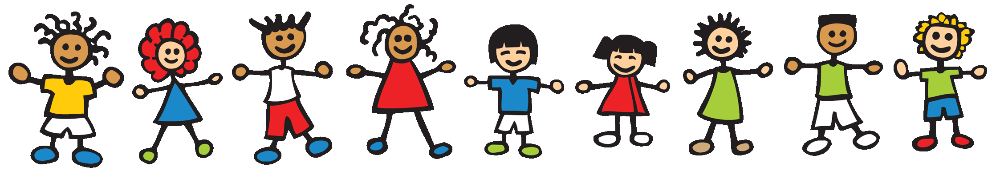